# Environment Setup

In [1]:
!pip install gpytoolbox

In [1]:
import gpytoolbox as gpy
import numpy as np
import matplotlib.pyplot as plt
import utils
import torch
from torch.utils.data import DataLoader


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device: {}".format(device))

Using device: cuda


# Dataset

In [2]:
from torchvision import transforms

def pcmnist(batch_size=16, size=128, num_samples=300, path_to_data='mnist_data/', augment=False, label=None):
    """PointCloudMNIST dataloader.

    Parameters
    ----------
    batch_size : int

    size : int
        Size (height and width) of each image. Default is 28 for no resizing.

    path_to_data : string
        Path to MNIST data files.
    """
    all_transforms = transforms.Compose([
        transforms.Resize(size),
    ])

    train_data = utils.PointCloudMNISTDataset(path_to_data, train=True, download=True,
                                transform=all_transforms, num_samples=num_samples,random_seed=2, augment=augment)

    if label is not None:
        train_idx = train_data.targets == label
        train_data.data = train_data.train_data[train_idx]
        train_data.targets = train_data.train_labels[train_idx]    

    test_data = utils.PointCloudMNISTDataset(path_to_data, train=False,
                               transform=all_transforms, num_samples=num_samples,random_seed=2, augment=False)
    
    if label is not None:
        test_idx = test_data.targets == label
        test_data.data = test_data.test_data[test_idx]
        test_data.targets = test_data.test_labels[test_idx]    

    train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)
    test_loader = DataLoader(test_data, batch_size=batch_size, shuffle=True)

    return train_loader, test_loader

(500, 2) (500,)


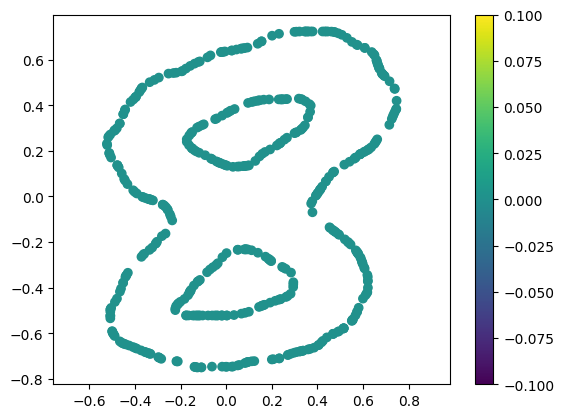

(500, 2) (500,)


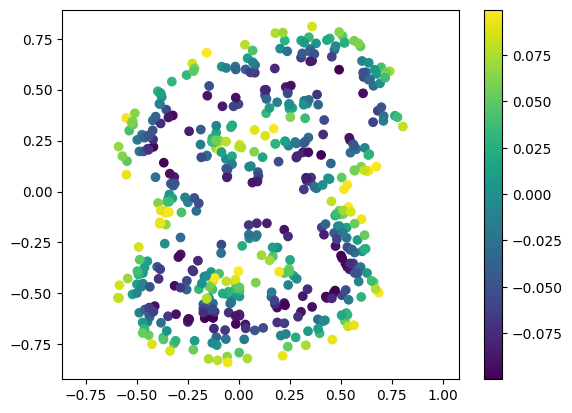

tensor([8, 4, 7, 5, 9, 0, 7, 0, 9, 2, 3, 1, 8, 7, 7, 9, 1, 5, 2, 1, 0, 0, 2, 5,
        8, 1, 0, 4, 9, 2, 1, 1, 8, 0, 6, 9, 2, 3, 3, 2, 4, 1, 4, 5, 1, 9, 8, 4,
        1, 0, 2, 6, 7, 2, 1, 7, 5, 2, 0, 0, 1, 5, 6, 3, 5, 9, 8, 6, 1, 6, 9, 3,
        7, 2, 7, 3, 0, 4, 7, 9, 3, 2, 3, 0, 0, 9, 0, 5, 0, 2, 5, 4, 4, 7, 7, 2,
        5, 6, 7, 9, 5, 3, 9, 5, 5, 4, 6, 6, 9, 6, 1, 0, 3, 1, 7, 0, 8, 6, 0, 9,
        7, 8, 6, 1, 6, 3, 9, 6])


In [12]:
BATCH_SIZE=128
IMG_SIZE=128
SAMPLE_SIZE = 500
train_dataloader, test_dataloader = pcmnist(batch_size=BATCH_SIZE, size=IMG_SIZE, num_samples=SAMPLE_SIZE)
#_, test_dataloader = pcmnist(batch_size=BATCH_SIZE, size=IMG_SIZE, num_samples=SAMPLE_SIZE)
i = 0
for Xs, Ys, normals, target in test_dataloader:
  X = Xs[0].numpy()
  Y = Ys[0].numpy()
  print(X.shape, Y.shape)

  plt.scatter(X[:,0],X[:,1], c=Y)
  plt.axis("equal")
  plt.colorbar()
  plt.show()

  #X, Y = utils.data.generate_pts_from_normals(X, normals[0].numpy(), n_points=X.shape[0]*2)
  X, Y = utils.data.generate_pts_from_normals(X, normals[0].numpy())

  print(X.shape, Y.shape)

  plt.scatter(X[:,0],X[:,1], c=Y)
  plt.axis("equal")
  plt.colorbar()
  plt.show()
  print(target)
  i +=1
  
  if i == 1:
    break

## Utils

In [13]:
def plot_neural_process(xs, ys, mu, std, X,y, grid_size, plot_sample=1):
    """
    Plot Mean and Std of Neural Process side by side.

    Parameters:
    - xs: x grid values
    - ys: y grid values
    - mu: mean tensor values
    - std: standard deviation tensor values
    - X: scatter plot data
    """
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    X = X.cpu()
    y = y.cpu().numpy()
    print(X.shape)
    # Mean of Neural Process plot
    axes[0].set_title("Mean of Neural Process")
    c1 = axes[0].pcolormesh(xs, ys, mu.cpu().view((grid_size,grid_size)).detach().numpy(), shading='gouraud', cmap="viridis")
    fig.colorbar(c1, ax=axes[0])
    axes[0].contour(xs, ys, mu.cpu().view((grid_size,grid_size)).detach().numpy(), levels=[0], colors='black')
    axes[0].scatter(X[0][:,0].numpy(), X[0][:,1].numpy(), c="k")

    # Std of Neural Process plot
    axes[1].set_title("Std of Neural Process")
    c2 = axes[1].pcolormesh(xs, ys, std.cpu().view((grid_size,grid_size)).detach().numpy(), shading='gouraud', cmap="plasma")
    fig.colorbar(c2, ax=axes[1])
    axes[1].scatter(X[0][:,0].numpy(), X[0][:,1].numpy(), c="k")
    
    plt.tight_layout()
    plt.show()

    if plot_sample > 0:
        m = torch.distributions.normal.Normal(mu, std)
        for i in range(plot_sample):
            sample = m.rsample().detach()

            plt.title("Sample of Neural Process")
            plt.pcolormesh(xs,ys,sample.cpu().reshape((grid_size,grid_size)).detach().numpy(),shading='gouraud',cmap="plasma")
            plt.colorbar()
            plt.contour(xs,ys,sample.cpu().reshape((grid_size,grid_size)).detach().numpy(),levels=[0], colors='black')
            plt.scatter(X[0][:,0].numpy(), X[0][:,1].numpy(),  c="k")
            plt.tight_layout()
            plt.show()

In [14]:
def get_context_and_target(x, normals, n_context, n_target):
    # Ensure n_context is less than or equal to n_target
    assert n_context <= n_target, "n_context should be less than or equal to n_target"

    batch_size = x.size(0)
    
    x_context_list, y_context_list, x_target_list, y_target_list = [], [], [], []
    
    for b in range(batch_size):
        # Sample n_target indices from the range [0, x.size(1)-1]
        target_indices = torch.randperm(x.size(1))[:n_target]

        # Get x_target and y_target values for the batch
        x_target_b = x[b, target_indices]
        normals_target_b = normals[b, target_indices]

        # From the n_target indices, subsample n_context indices
        context_indices = torch.randperm(n_target)[:n_context]

        # Get x_context and y_context values for the batch
        #print(context_indices.shape, context_indices)
        #print(x_target_b.shape, y_target_b.shape)
        x_context_b = x_target_b[context_indices]
        normals_context_b = normals_target_b[context_indices]

        x_context_b, y_context_b = utils.data.generate_pts_from_normals(x_context_b.cpu().numpy(), normals_context_b.cpu().numpy(), n_points=x_context_b.shape[0]*2)
        x_context_b, y_context_b = torch.tensor(x_context_b, dtype=torch.float32), torch.tensor(y_context_b,dtype=torch.float32)

        x_target_b, y_target_b = utils.data.generate_pts_from_normals(x_target_b.cpu().numpy(), normals_target_b.cpu().numpy(), n_points=x_target_b.shape[0]*2)
        x_target_b, y_target_b = torch.tensor(x_target_b, dtype=torch.float32), torch.tensor(y_target_b,dtype=torch.float32)
        
        x_context_list.append(x_context_b)
        y_context_list.append(y_context_b)
        x_target_list.append(x_target_b)
        y_target_list.append(y_target_b)
    
    x_context = torch.stack(x_context_list)
    y_context = torch.stack(y_context_list)
    x_target = torch.stack(x_target_list)
    y_target = torch.stack(y_target_list)

    return x_context, y_context, x_target, y_target

In [15]:
def test(model, dataloader, writer=None, plot=True, global_step=None, seed=42, title='', size=50, grid_size=100, use_normals=False,
        predict_twice=True):
    model.eval()
    model.to(device)
    with torch.no_grad():
        Xs, Ys, _, labels = next(iter(dataloader))
        context_x, context_y, label = Xs[0], Ys[0], labels[0]
        context_indices = torch.randperm(context_x.size(0))[:size]
        context_x = torch.Tensor(context_x[context_indices]).reshape((1,size,2)).to(device)
        context_y = torch.Tensor(context_y[context_indices]).reshape((1,size,1)).to(device)
        #print(context_x.shape, context_y.shape)
        
        # Create a set of target points corresponding to entire [-pi, pi] range
        xs = np.linspace(-1,1,grid_size)
        ys = np.linspace(-1,1,grid_size)
        Xs,Ys = np.meshgrid(xs,ys)
        Xs = Xs.flatten()
        Ys = Ys.flatten()
        grid = np.vstack((Xs,Ys)).T
        target_x = torch.Tensor(grid).reshape(1,grid_size**2,2).to(device)

        #print(context_x.shape, context_y.shape, target_x.shape)
        y_pred, kl, loss, z, y_std = model(context_x, context_y, target_x)

        # if writer is not None:
        #     writer.add_scalar('val/loss', loss, global_step=global_step)
        #     writer.add_scalar('val/y_std', y_std.mean(), global_step=global_step)
        #     writer.add_scalar('val/mse_loss', mse_loss, global_step=global_step)
        #     writer.add_scalar('val/kl', kl.mean(), global_step=global_step)

        if plot:
            print("Original Label: ", label)
            plot_neural_process(xs,ys,y_pred,y_std, context_x, context_y, grid_size, plot_sample=0)
            if predict_twice:
                y_pred2, kl, loss, z, y_std = model(context_x, context_y, target_x, sample=True)
                plot_neural_process(xs,ys,y_pred2,y_std, context_x, context_y, grid_size, plot_sample=0)

            if writer is not None:
                writer.add_figure('test', global_step=global_step, close=False)
            plt.show()

    return y_pred, kl, loss, y_std

In [16]:
def test_progress(model, dataloader, writer=None, plot=True, global_step=None, seed=42, title='', sizes=[50,100], grid_size=100, use_normals=False, multiple=10):
    model.eval()
    model.to(device)
    with torch.no_grad():
        X, Y, normals, labels = next(iter(dataloader))
        for size in sizes:
            context_x, context_y, normal, label = X[0], Y[0],normals[0], labels[0]
            context_indices = torch.randperm(context_x.size(0))[:size]

            # context_x, context_y = utils.data.generate_pts_from_normals(context_x[context_indices].cpu().numpy(), normal[context_indices].cpu().numpy(),
            #                                                             #n_points=context_x[context_indices].shape[0]*2
            #                                                             )
            context_x = context_x[context_indices]
            context_y = context_y[context_indices]
            context_x, context_y = torch.tensor(context_x, dtype=torch.float32), torch.tensor(context_y,dtype=torch.float32)
            context_x = context_x.reshape((1,size,2)).to(device)
            context_y = context_y.reshape((1,size,1)).to(device)
            #print(context_x.shape, context_y.shape)
            
            # Create a set of target points corresponding to entire [-pi, pi] range
            xs = np.linspace(-1,1,grid_size)
            ys = np.linspace(-1,1,grid_size)
            Xs,Ys = np.meshgrid(xs,ys)
            Xs = Xs.flatten()
            Ys = Ys.flatten()
            grid = np.vstack((Xs,Ys)).T
            target_x = torch.Tensor(grid).reshape(1,grid_size**2,2).to(device)

            #print(context_x.shape, context_y.shape, target_x.shape)
            y_pred, kl, loss, z, y_std = model(context_x, context_y, target_x)

            # if writer is not None:
            #     writer.add_scalar('val/loss', loss, global_step=global_step)
            #     writer.add_scalar('val/y_std', y_std.mean(), global_step=global_step)
            #     writer.add_scalar('val/mse_loss', mse_loss, global_step=global_step)
            #     writer.add_scalar('val/kl', kl.mean(), global_step=global_step)

            if plot:
                print("Original Label: ", label)
                print("N context points: ", size)
                plot_neural_process(xs,ys,y_pred,y_std, context_x, context_y, grid_size, plot_sample=0)
                for i in range(multiple):
                    print("Sample: ", i)
                    y_pred2, kl, loss, z, y_std = model(context_x, context_y, target_x, sample=True)
                    plot_neural_process(xs,ys,y_pred2,y_std, context_x, context_y, grid_size, plot_sample=0)

                if writer is not None:
                    writer.add_figure('test', global_step=global_step, close=False)
                plt.show()

In [17]:
from tqdm import tqdm

def evaluate(model, n=100):
    return torch.stack([
        test(model)[2] for _ in tqdm(range(n))
    ]).mean().cpu()

# Attentive Neural Process

In [18]:
from src.model import LatentModel

hparams = dict(
    x_dim=2,
    y_dim=1,
    hidden_dim=128,
    latent_dim=128,
    n_latent_encoder_layers=3,
    n_det_encoder_layers=3,
    n_decoder_layers=3,
    attention_layers=2,
    latent_enc_self_attn_type="dot", # dot
    det_enc_self_attn_type="dot",
    det_enc_cross_attn_type="multihead",
    use_lvar=False,
    use_rnn=False)

model = LatentModel(**hparams).to(device)
optim = torch.optim.Adam(model.parameters(), lr=1e-4)

n_context = 100
n_target = 400
epochs = 30
PRINT_AFTER = 500

## Training Model

In [19]:
def train(model, optim, train_dataloader, test_dataloader, epochs, n_context, n_target, plot=True):
    for epoch in range(epochs):
        epoch_loss = 0.
        with tqdm(train_dataloader, unit="batch") as tepoch:
            for data in tepoch:
                tepoch.set_description(f"Epoch {epoch}")
                model.train()

                x, y, normals, target = data
                x=x.to(device)
                normals = normals.to(device)
                #y=y.unsqueeze(-1).to(device)

                context_x, context_y, target_x, target_y = get_context_and_target(x, normals, n_context, n_target)
                #print(context_x.shape, context_y.shape, target_x.shape, target_y.shape)
                context_x = context_x.to(device)
                context_y = context_y.unsqueeze(-1).to(device)
                target_x = target_x.to(device)
                target_y = target_y.unsqueeze(-1).to(device)
                #print(context_x.shape, context_y.shape, target_x.shape, target_y.shape)
                optim.zero_grad()
                y_pred, kl, loss, mse_loss, y_std = model(context_x, context_y, target_x,target_y)
                epoch_loss += loss.item()
                loss.backward()
                optim.step()

                if (tepoch.n - 1) % PRINT_AFTER == 0:
                    _, _, _, _ = test(
                        model, test_dataloader, plot=plot, global_step=tepoch.n-1, size=n_context)
                    # print(
                    #     f"train: {tepoch.n - 1} loss={loss.item(): 4.4g} val_loss={val_loss.item(): 4.4g}"
                    # )
                tepoch.set_postfix(loss=loss.item())

        print("Epoch: {}, Avg_loss: {}".format(epoch, epoch_loss / len(train_dataloader)))
            

Epoch 0:   0%|                   | 1/469 [00:01<05:52,  1.33batch/s, loss=-2.18]

Original Label:  tensor(1)
torch.Size([1, 100, 2])


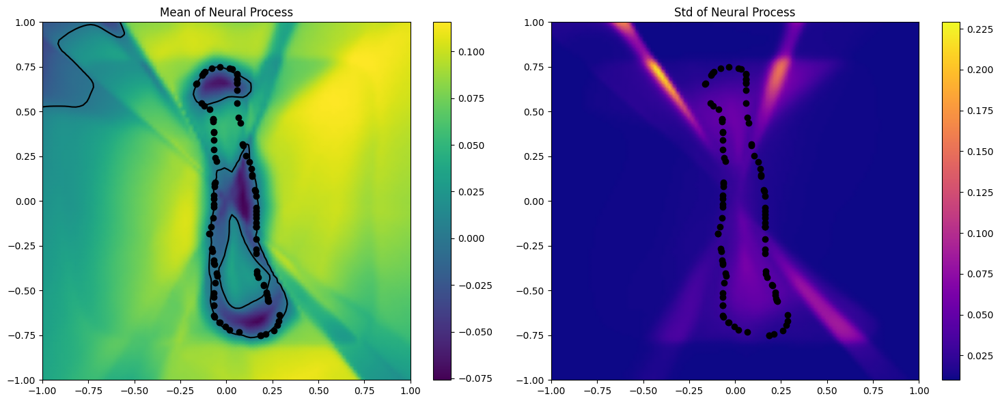

torch.Size([1, 100, 2])


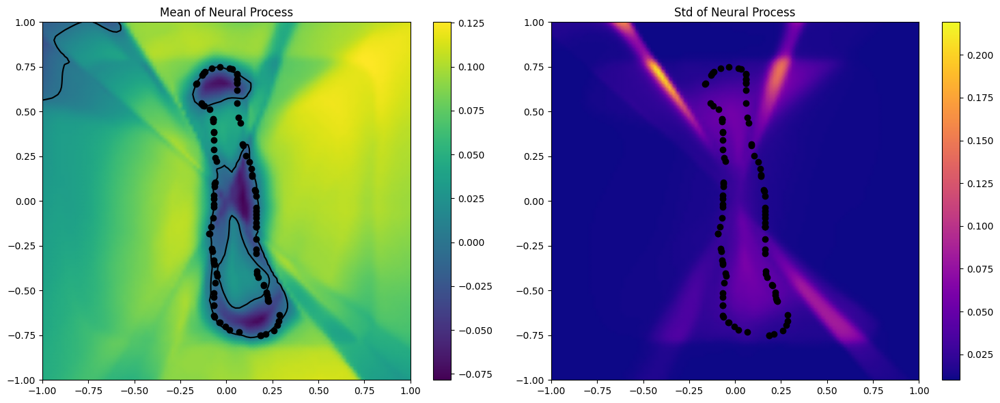

Epoch 0:  87%|██████████████▊  | 409/469 [04:44<00:41,  1.44batch/s, loss=-2.18]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 0: 100%|█████████████████| 469/469 [05:25<00:00,  1.44batch/s, loss=-2.22]


Epoch: 0, Avg_loss: -2.1915604742859474


Epoch 1:   0%|                   | 1/469 [00:00<05:54,  1.32batch/s, loss=-2.23]

Original Label:  tensor(8)
torch.Size([1, 100, 2])


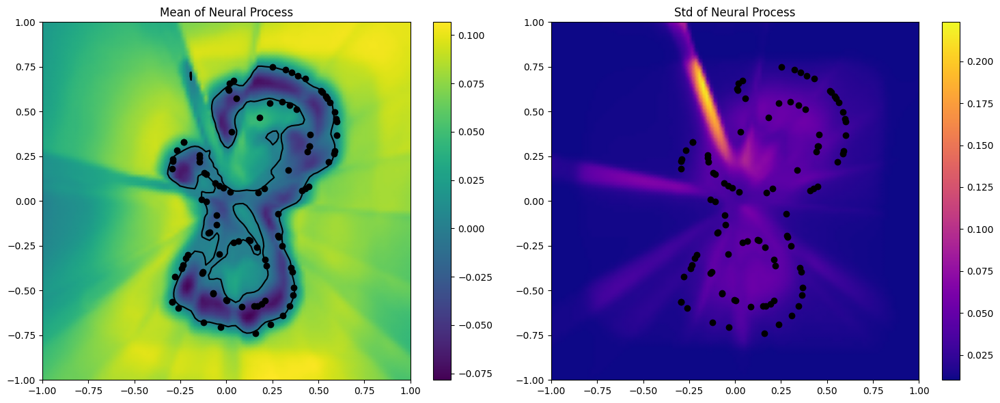

torch.Size([1, 100, 2])


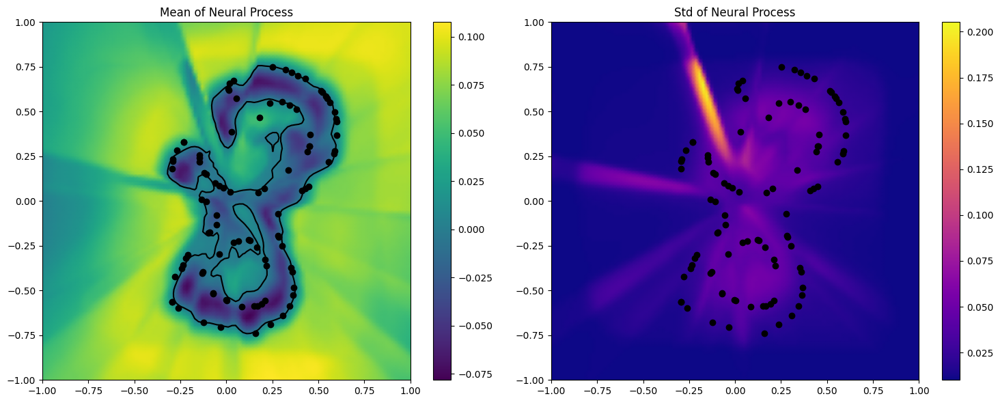

Epoch 1:  29%|█████            | 138/469 [01:36<03:54,  1.41batch/s, loss=-2.18]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 1: 100%|█████████████████| 469/469 [05:24<00:00,  1.45batch/s, loss=-2.19]


Epoch: 1, Avg_loss: -2.211340272858707


Epoch 2:   0%|                   | 1/469 [00:00<05:43,  1.36batch/s, loss=-2.21]

Original Label:  tensor(3)
torch.Size([1, 100, 2])


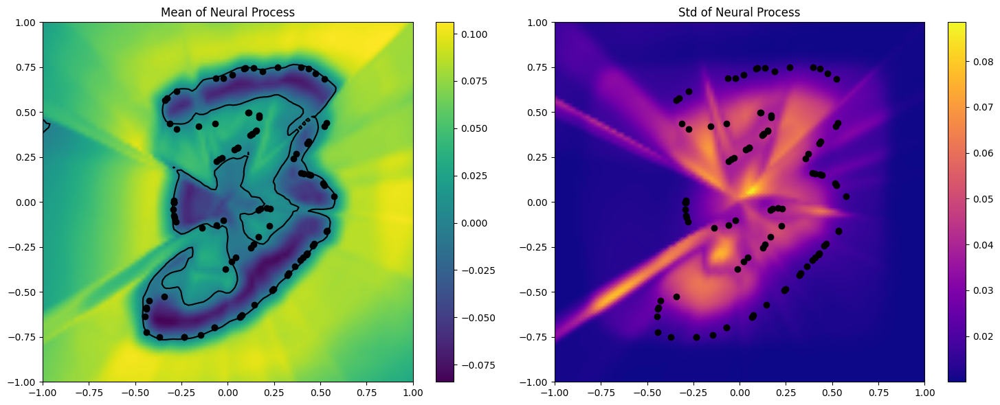

torch.Size([1, 100, 2])


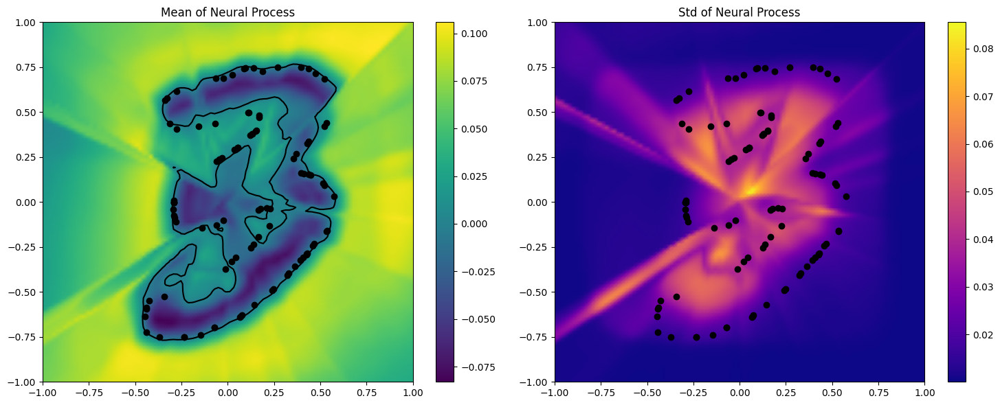

Epoch 2:  55%|█████████▎       | 257/469 [02:58<02:25,  1.46batch/s, loss=-2.23]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 2: 100%|██████████████████| 469/469 [05:24<00:00,  1.44batch/s, loss=-2.2]


Epoch: 2, Avg_loss: -2.2256976937942667


Epoch 3:   0%|                   | 1/469 [00:00<05:34,  1.40batch/s, loss=-2.22]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


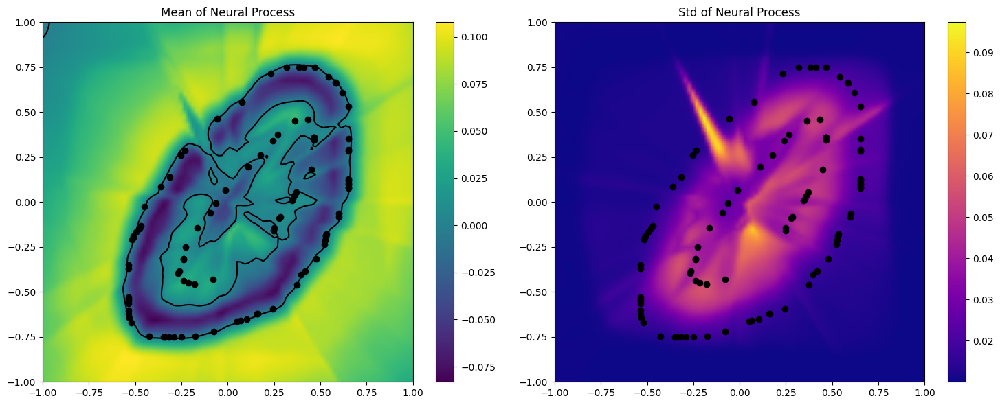

torch.Size([1, 100, 2])


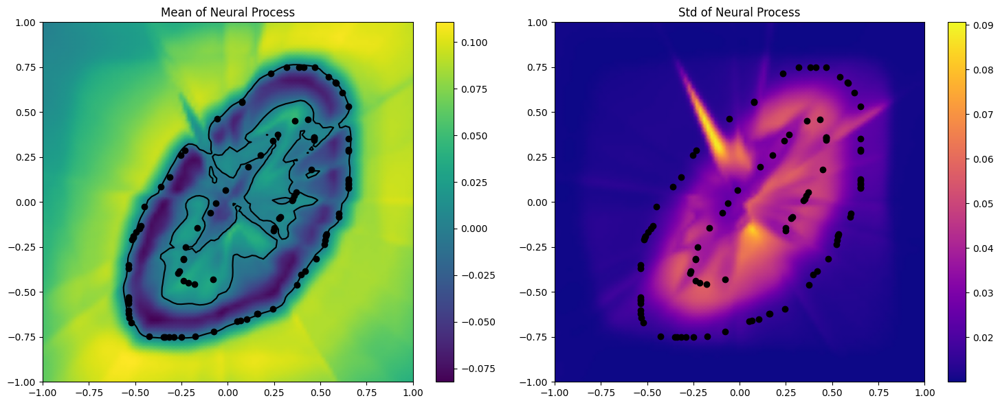

Epoch 3:  82%|█████████████▉   | 384/469 [04:27<00:58,  1.46batch/s, loss=-2.28]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 3: 100%|█████████████████| 469/469 [05:26<00:00,  1.44batch/s, loss=-2.25]


Epoch: 3, Avg_loss: -2.241631206418914


Epoch 4:   0%|                   | 1/469 [00:01<05:48,  1.34batch/s, loss=-2.24]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


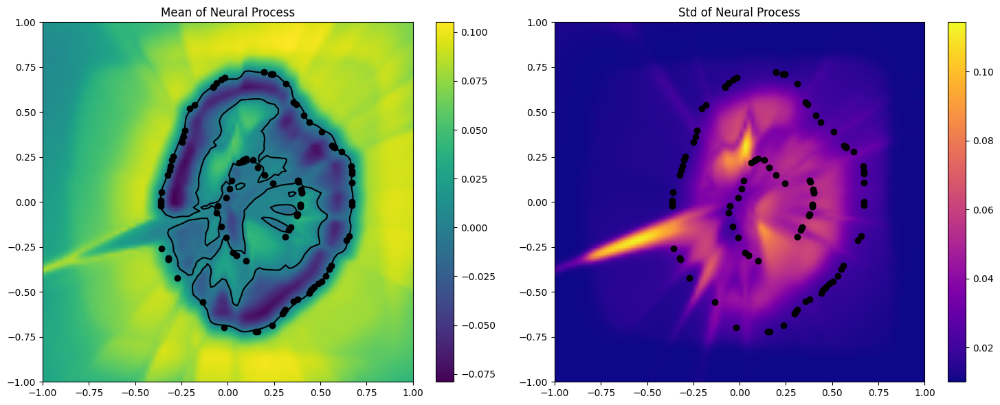

torch.Size([1, 100, 2])


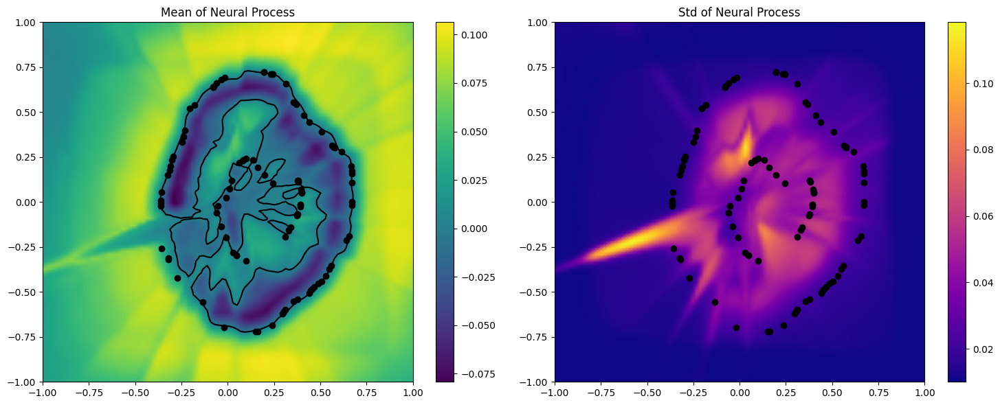

Epoch 4:   9%|█▌                | 42/469 [00:30<05:02,  1.41batch/s, loss=-2.26]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 4: 100%|█████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.22]


Epoch: 4, Avg_loss: -2.252529579947498


Epoch 5:   0%|                   | 1/469 [00:00<05:31,  1.41batch/s, loss=-2.28]

Original Label:  tensor(1)
torch.Size([1, 100, 2])


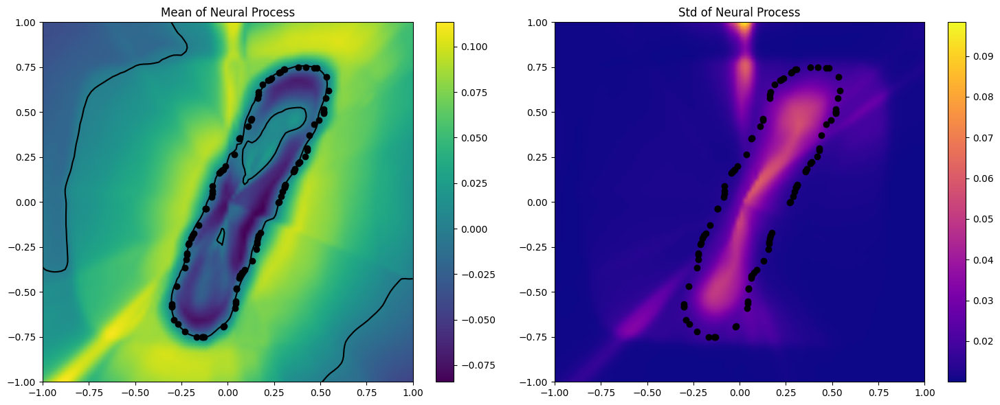

torch.Size([1, 100, 2])


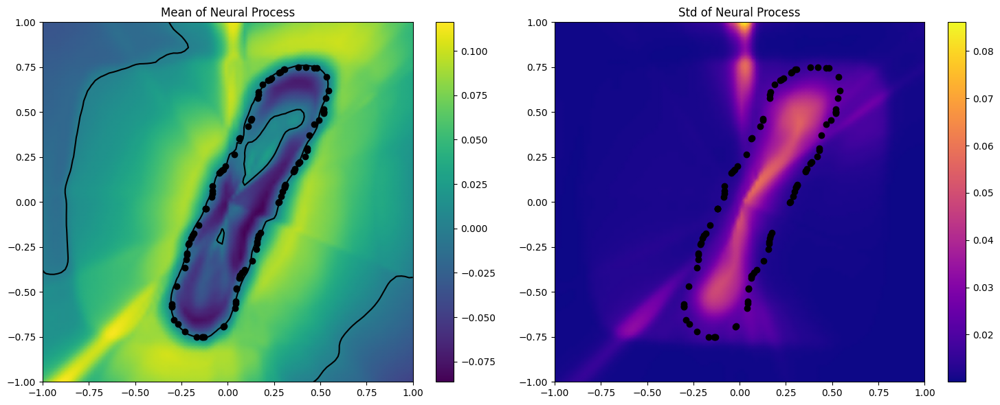

Epoch 5:  45%|███████▋         | 212/469 [02:32<02:59,  1.43batch/s, loss=-2.26]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 5: 100%|█████████████████| 469/469 [05:34<00:00,  1.40batch/s, loss=-2.25]


Epoch: 5, Avg_loss: -2.26388975043795


Epoch 6:   0%|                   | 1/469 [00:00<05:37,  1.39batch/s, loss=-2.24]

Original Label:  tensor(3)
torch.Size([1, 100, 2])


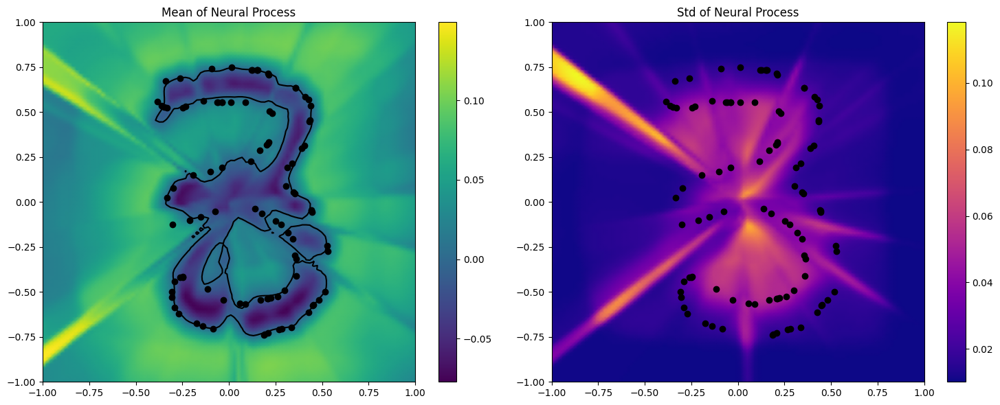

torch.Size([1, 100, 2])


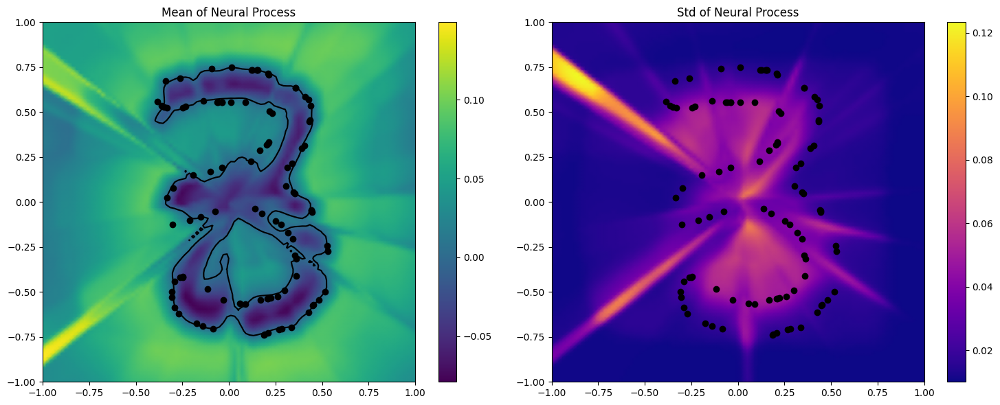

Epoch 6:   9%|█▋                | 43/469 [00:31<05:00,  1.42batch/s, loss=-2.28]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 6: 100%|█████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.26]


Epoch: 6, Avg_loss: -2.2773906960924553


Epoch 7:   0%|                   | 1/469 [00:00<05:43,  1.36batch/s, loss=-2.23]

Original Label:  tensor(1)
torch.Size([1, 100, 2])


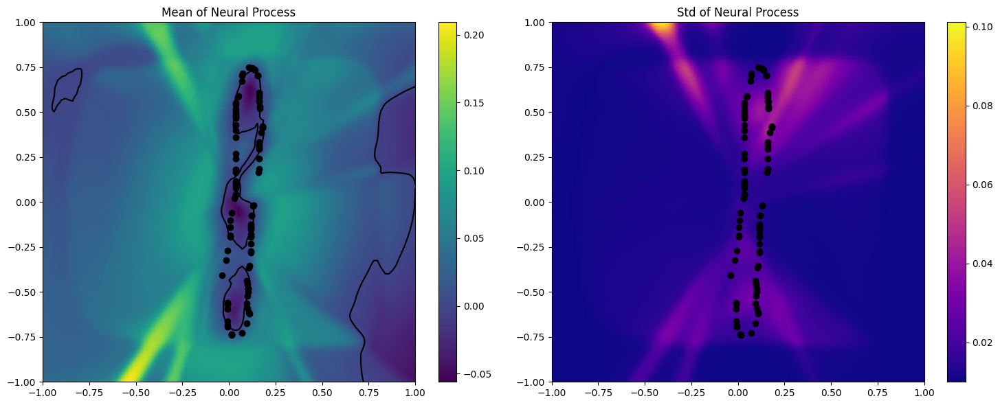

torch.Size([1, 100, 2])


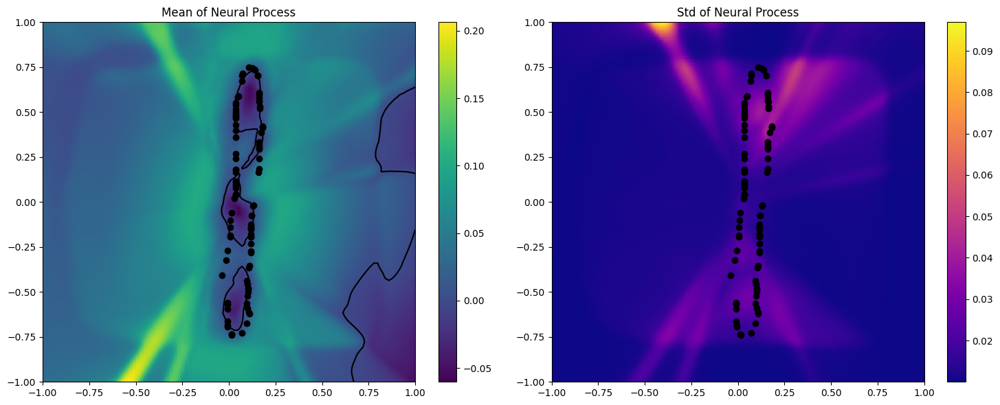

Epoch 7:  29%|█████▎            | 137/469 [01:38<03:54,  1.42batch/s, loss=-2.3]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 7: 100%|█████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.24]


Epoch: 7, Avg_loss: -2.2843977439123937


Epoch 8:   0%|                    | 1/469 [00:00<05:40,  1.37batch/s, loss=-2.3]

Original Label:  tensor(9)
torch.Size([1, 100, 2])


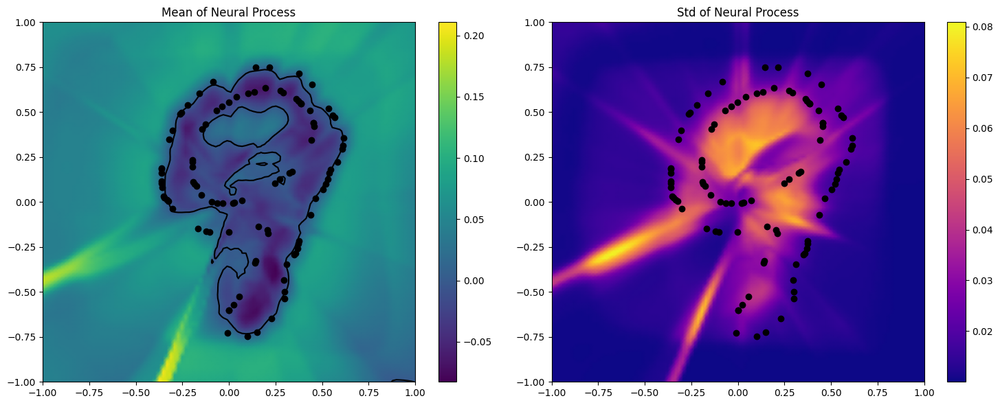

torch.Size([1, 100, 2])


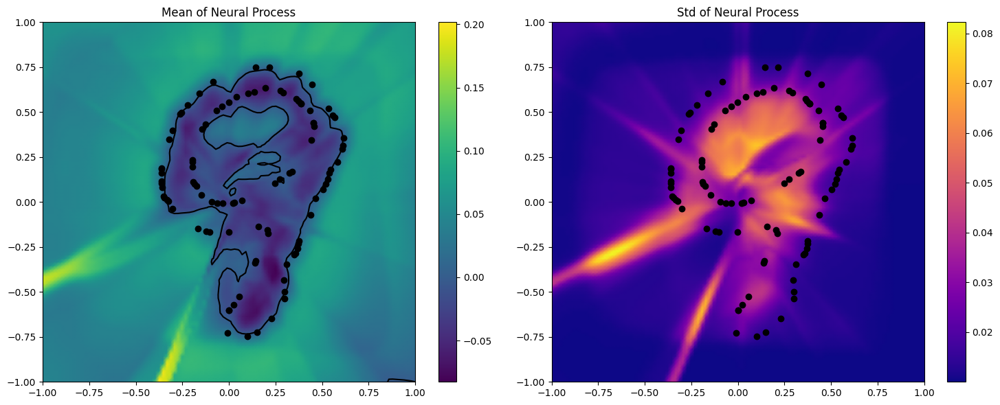

Epoch 8:  88%|███████████████▉  | 415/469 [04:54<00:37,  1.45batch/s, loss=-2.3]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 8: 100%|██████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.3]


Epoch: 8, Avg_loss: -2.2934612511063435


Epoch 9:   0%|                   | 1/469 [00:00<05:42,  1.37batch/s, loss=-2.29]

Original Label:  tensor(1)
torch.Size([1, 100, 2])


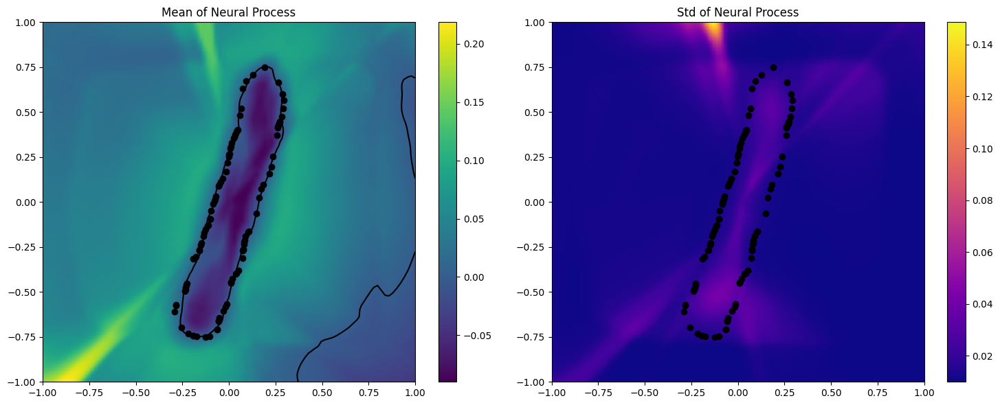

torch.Size([1, 100, 2])


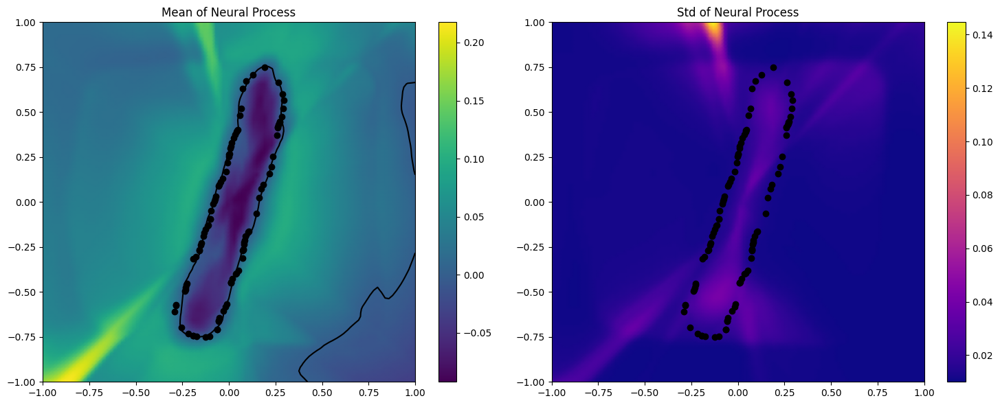

Epoch 9:  51%|████████▋        | 240/469 [02:50<02:40,  1.43batch/s, loss=-2.31]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 9: 100%|█████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.27]


Epoch: 9, Avg_loss: -2.3019190002351935


Epoch 10:   0%|                  | 1/469 [00:00<05:42,  1.37batch/s, loss=-2.33]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


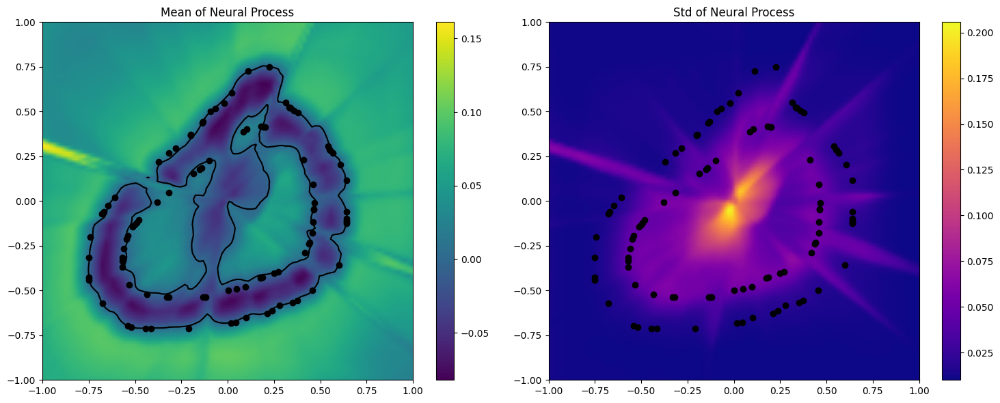

torch.Size([1, 100, 2])


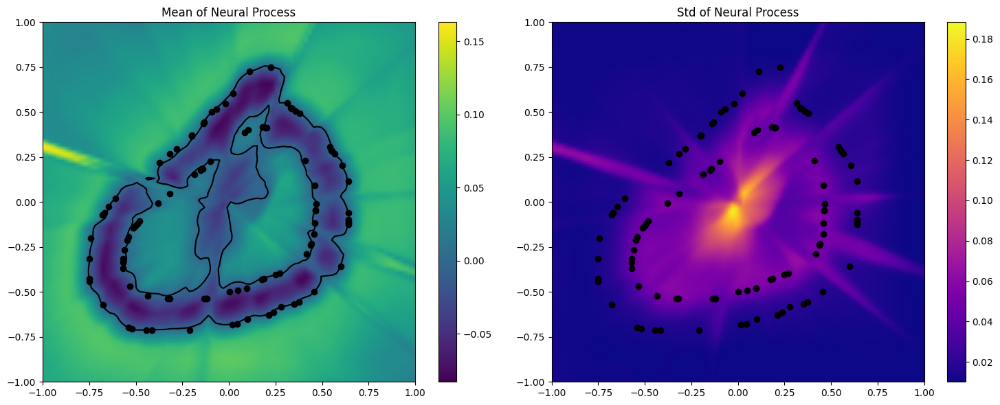

Epoch 10:  95%|███████████████▏| 446/469 [05:17<00:16,  1.42batch/s, loss=-2.35]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 10: 100%|████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.35]


Epoch: 10, Avg_loss: -2.30933732772941


Epoch 11:   0%|                  | 1/469 [00:01<06:00,  1.30batch/s, loss=-2.37]

Original Label:  tensor(4)
torch.Size([1, 100, 2])


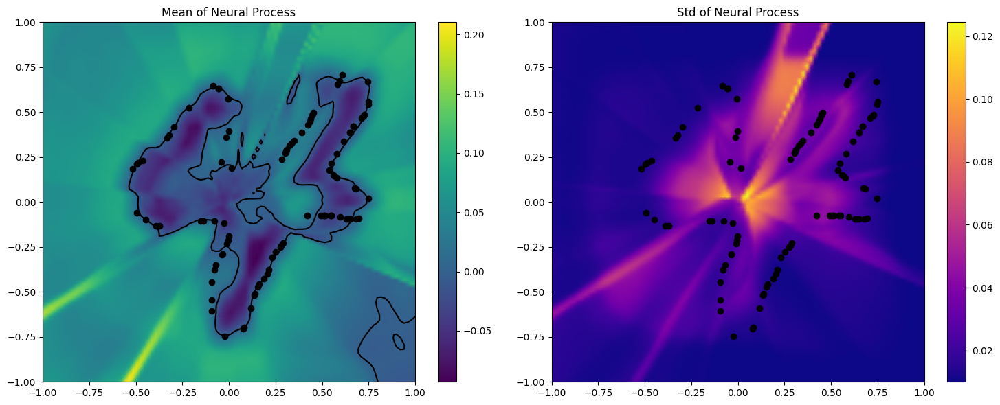

torch.Size([1, 100, 2])


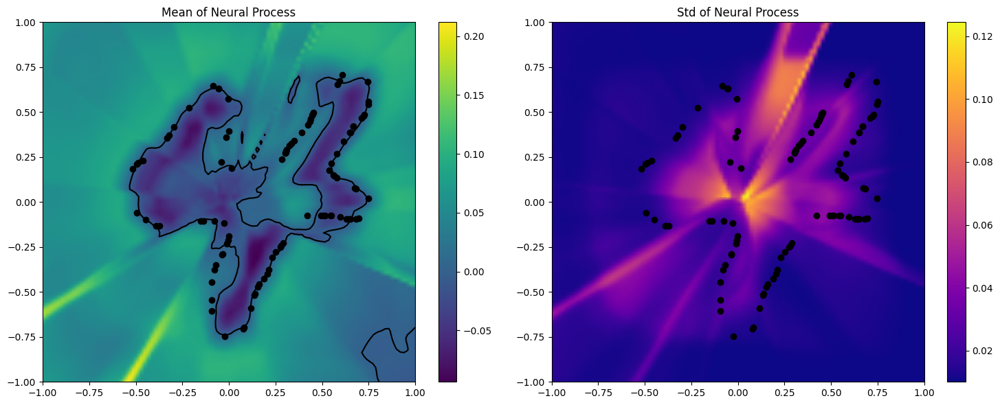

Epoch 11:  86%|█████████████▋  | 401/469 [04:45<00:47,  1.42batch/s, loss=-2.33]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 11: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.23]


Epoch: 11, Avg_loss: -2.317663814975763


Epoch 12:   0%|                  | 1/469 [00:00<05:44,  1.36batch/s, loss=-2.28]

Original Label:  tensor(2)
torch.Size([1, 100, 2])


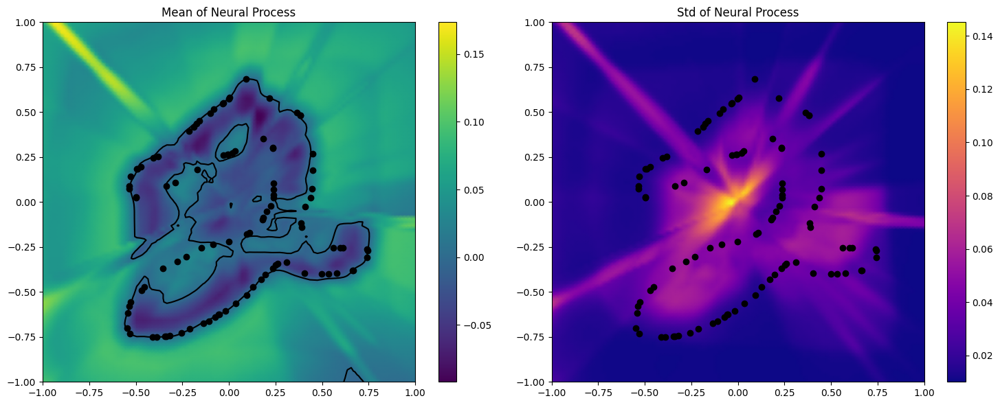

torch.Size([1, 100, 2])


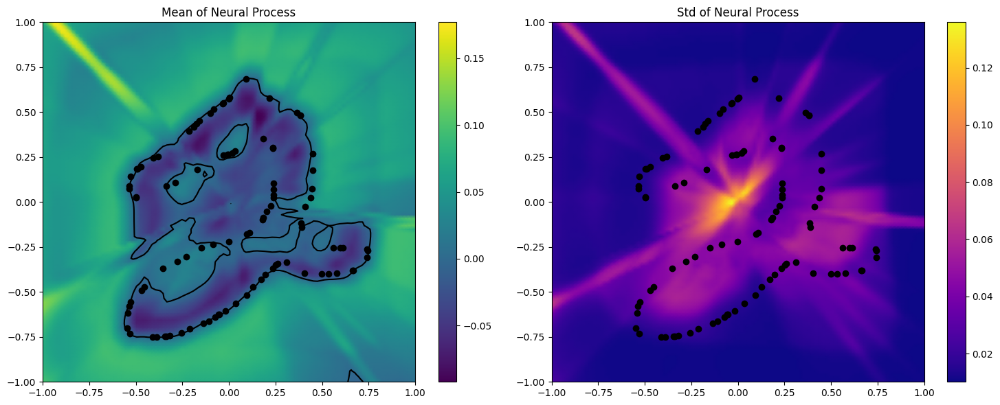

Epoch 12:  29%|████▋           | 136/469 [01:38<03:56,  1.41batch/s, loss=-2.31]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 12: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.31]


Epoch: 12, Avg_loss: -2.3235084217494486


Epoch 13:   0%|                  | 1/469 [00:00<05:42,  1.37batch/s, loss=-2.32]

Original Label:  tensor(8)
torch.Size([1, 100, 2])


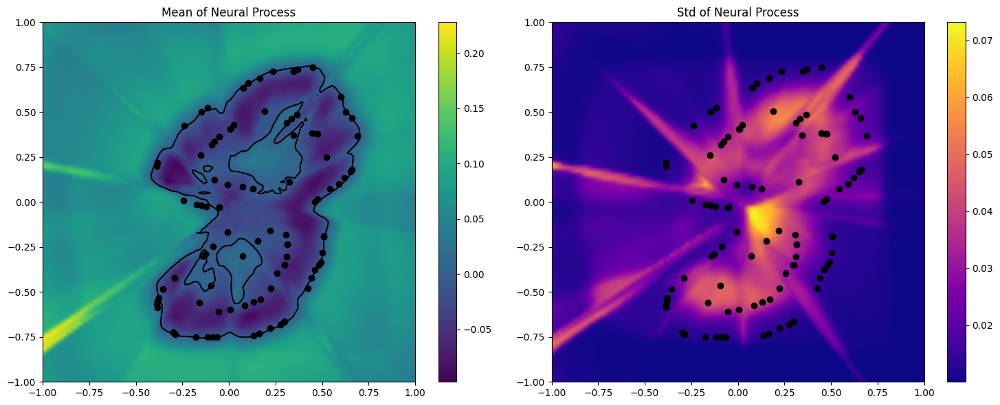

torch.Size([1, 100, 2])


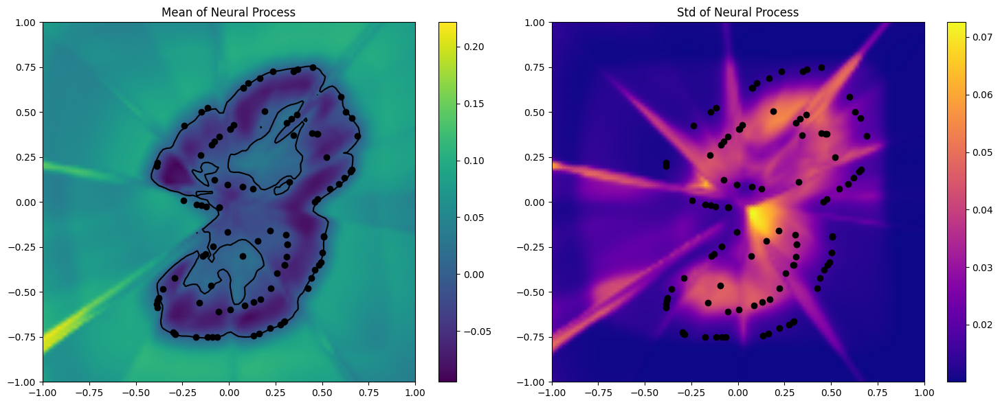

Epoch 13:  44%|███████         | 208/469 [02:28<03:03,  1.42batch/s, loss=-2.28]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 13: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.33]


Epoch: 13, Avg_loss: -2.3310889597894793


Epoch 14:   0%|                  | 1/469 [00:01<05:58,  1.31batch/s, loss=-2.31]

Original Label:  tensor(7)
torch.Size([1, 100, 2])


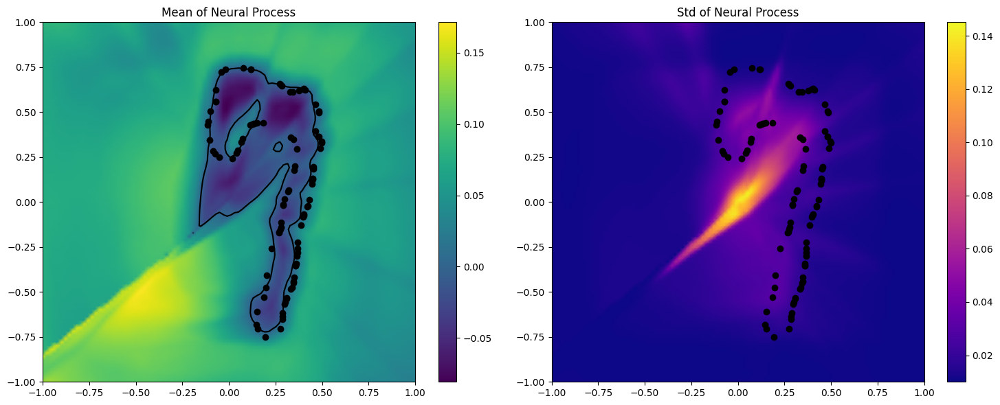

torch.Size([1, 100, 2])


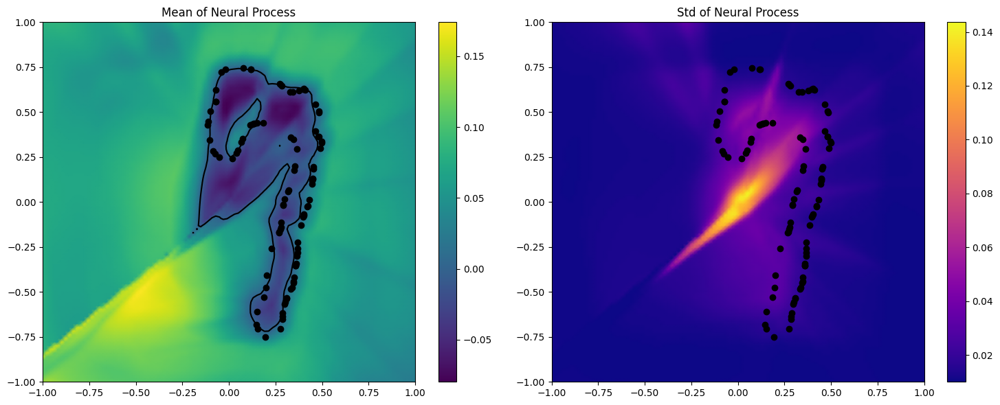

Epoch 14:  26%|████▏           | 122/469 [01:27<04:04,  1.42batch/s, loss=-2.35]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 14: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.32]


Epoch: 14, Avg_loss: -2.3366179125649587


Epoch 15:   0%|                  | 1/469 [00:01<06:16,  1.24batch/s, loss=-2.34]

Original Label:  tensor(6)
torch.Size([1, 100, 2])


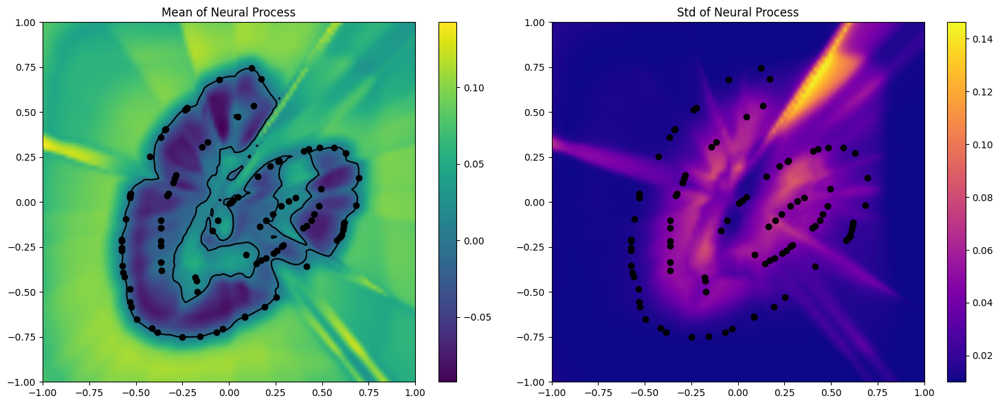

torch.Size([1, 100, 2])


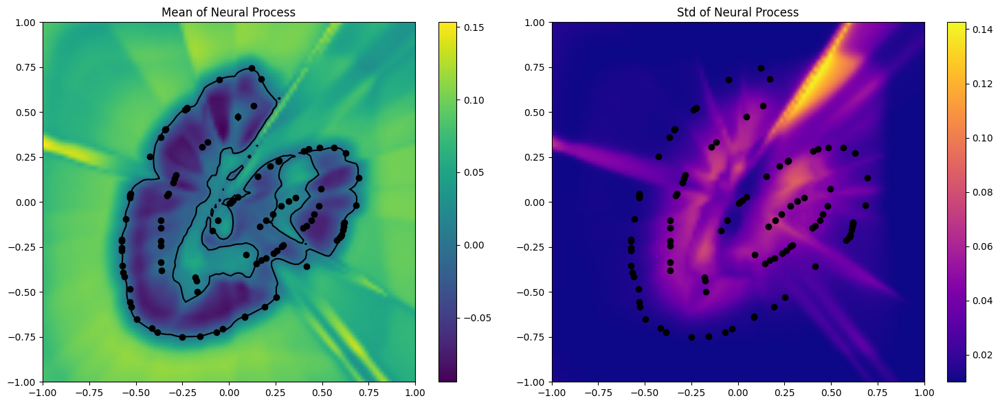

Epoch 15:  11%|█▉               | 53/469 [00:39<04:57,  1.40batch/s, loss=-2.31]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 15: 100%|████████████████| 469/469 [05:34<00:00,  1.40batch/s, loss=-2.28]


Epoch: 15, Avg_loss: -2.3429947585693554


Epoch 16:   0%|                  | 1/469 [00:01<05:48,  1.34batch/s, loss=-2.37]

Original Label:  tensor(7)
torch.Size([1, 100, 2])


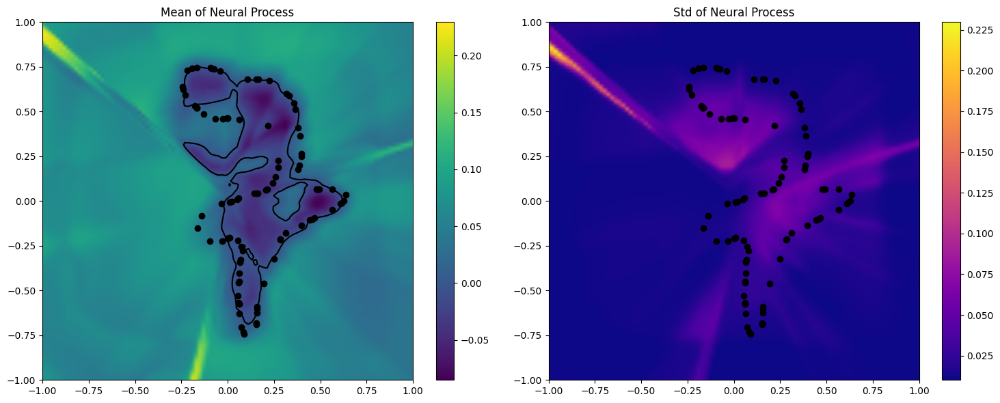

torch.Size([1, 100, 2])


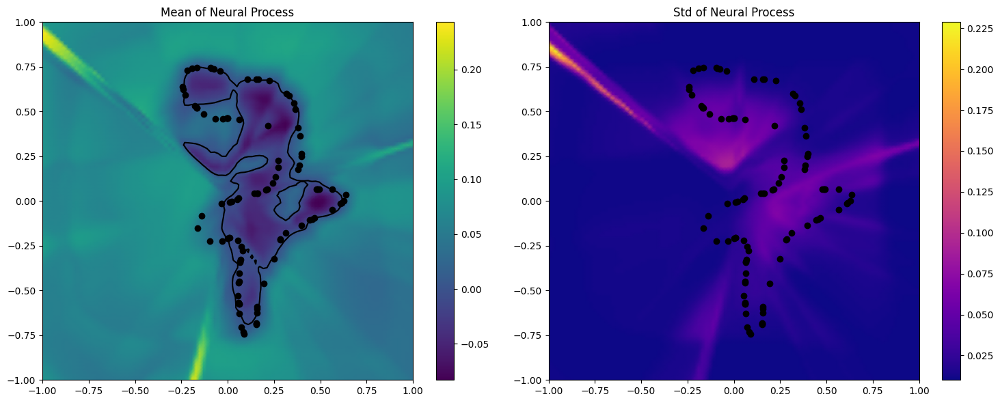

Epoch 16:  53%|█████████        | 249/469 [02:57<02:34,  1.42batch/s, loss=-2.4]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 16: 100%|████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.33]


Epoch: 16, Avg_loss: -2.3505338732875996


Epoch 17:   0%|                  | 1/469 [00:00<05:51,  1.33batch/s, loss=-2.34]

Original Label:  tensor(3)
torch.Size([1, 100, 2])


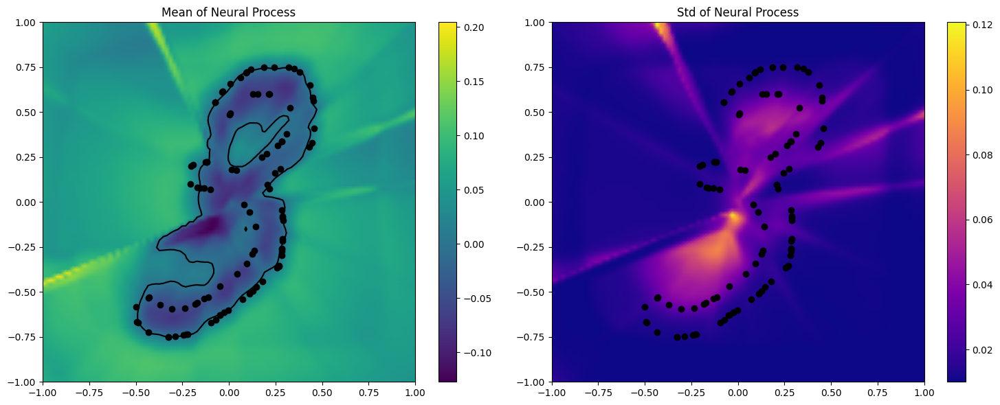

torch.Size([1, 100, 2])


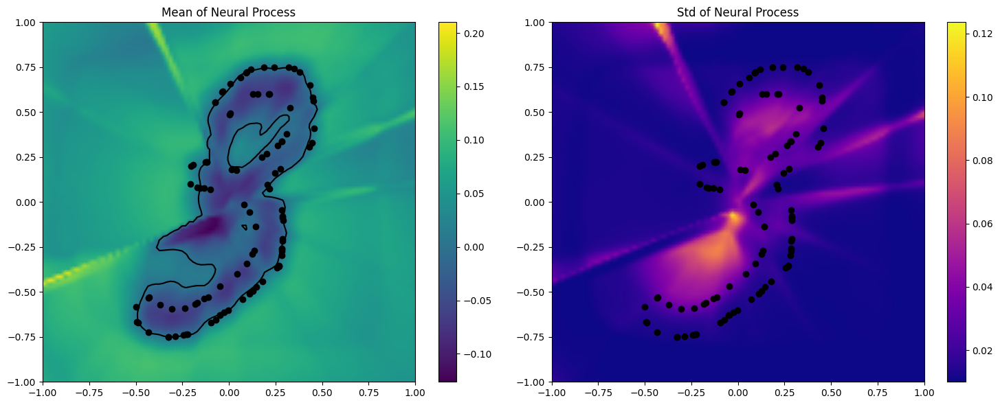

Epoch 17:  96%|███████████████▎| 448/469 [05:18<00:14,  1.44batch/s, loss=-2.37]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 17: 100%|████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.34]


Epoch: 17, Avg_loss: -2.355539415945122


Epoch 18:   0%|                  | 1/469 [00:01<06:03,  1.29batch/s, loss=-2.35]

Original Label:  tensor(4)
torch.Size([1, 100, 2])


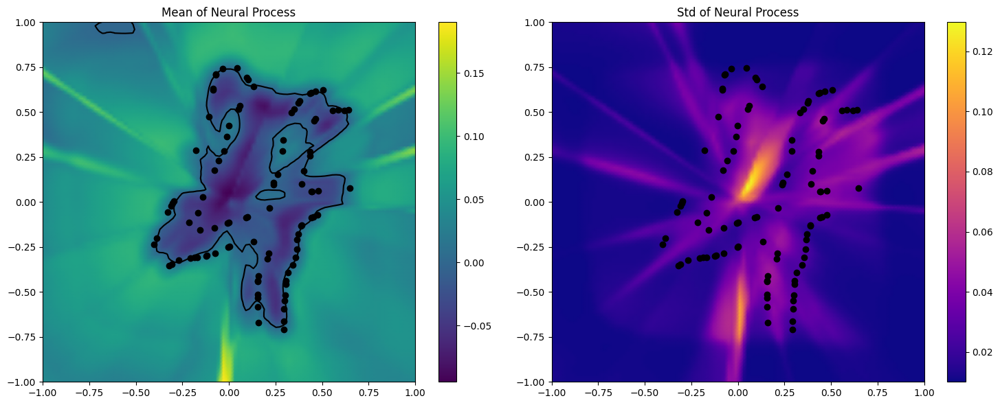

torch.Size([1, 100, 2])


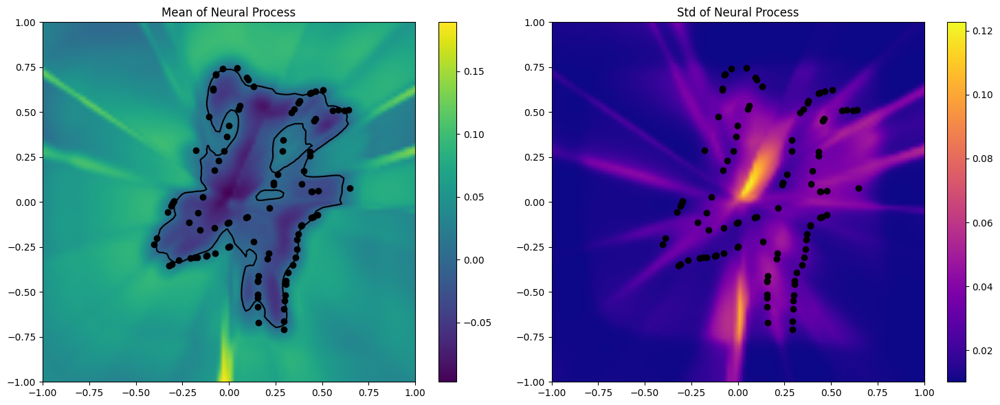

Epoch 18:   1%|                  | 3/469 [00:03<08:50,  1.14s/batch, loss=-2.33]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 18: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.31]


Epoch: 18, Avg_loss: -2.3605731529976004


Epoch 19:   0%|                   | 1/469 [00:00<05:49,  1.34batch/s, loss=-2.4]

Original Label:  tensor(1)
torch.Size([1, 100, 2])


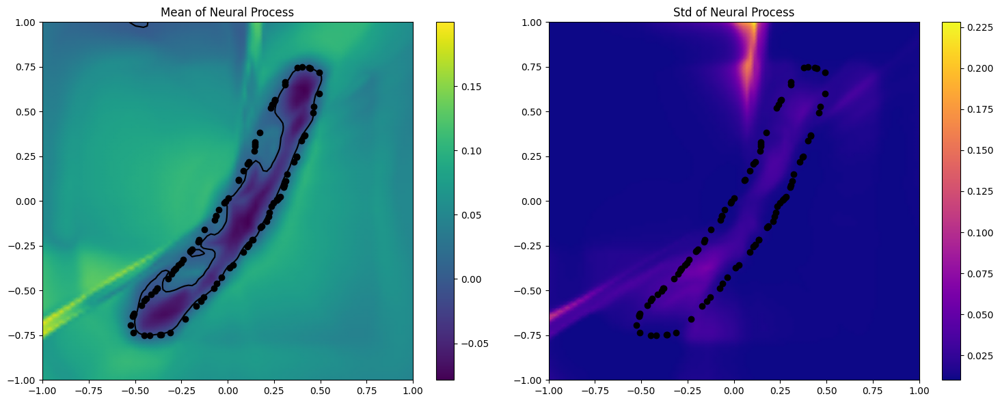

torch.Size([1, 100, 2])


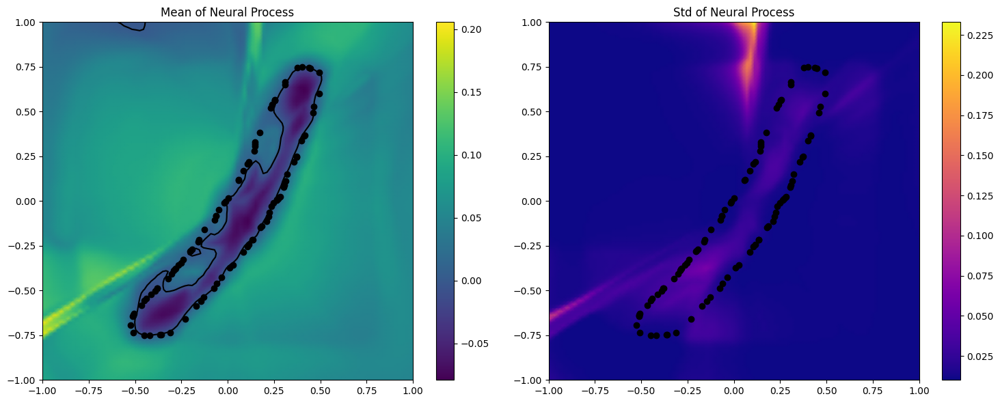

Epoch 19:  90%|██████████████▍ | 424/469 [05:02<00:31,  1.42batch/s, loss=-2.37]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 19: 100%|████████████████| 469/469 [05:34<00:00,  1.40batch/s, loss=-2.35]


Epoch: 19, Avg_loss: -2.36637645337119


Epoch 20:   0%|                  | 1/469 [00:00<05:52,  1.33batch/s, loss=-2.37]

Original Label:  tensor(3)
torch.Size([1, 100, 2])


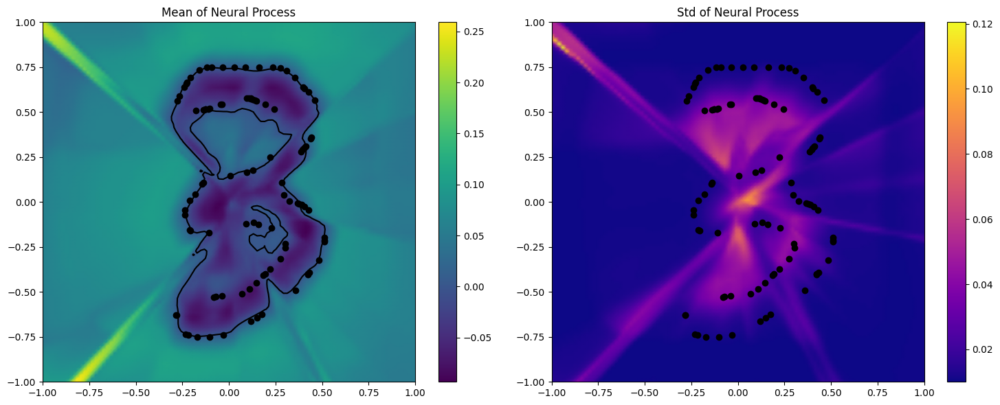

torch.Size([1, 100, 2])


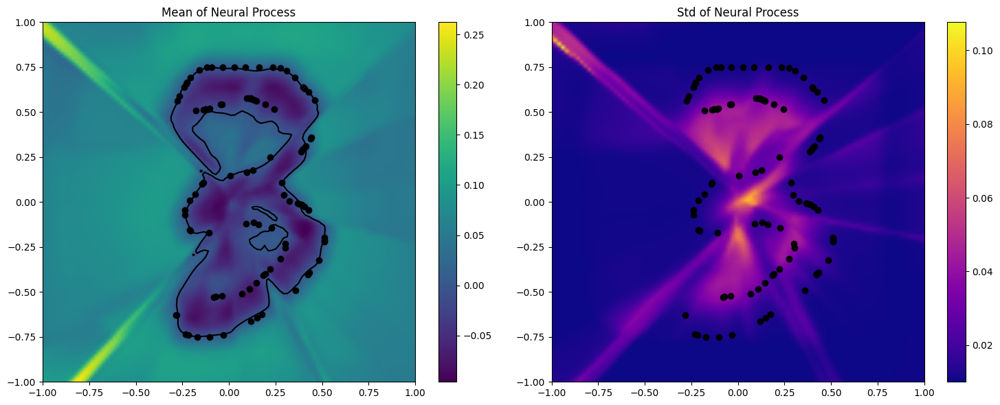

Epoch 20:  31%|████▉           | 146/469 [01:44<03:52,  1.39batch/s, loss=-2.41]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 20: 100%|████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.31]


Epoch: 20, Avg_loss: -2.371454623716472


Epoch 21:   0%|                  | 1/469 [00:00<05:51,  1.33batch/s, loss=-2.37]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


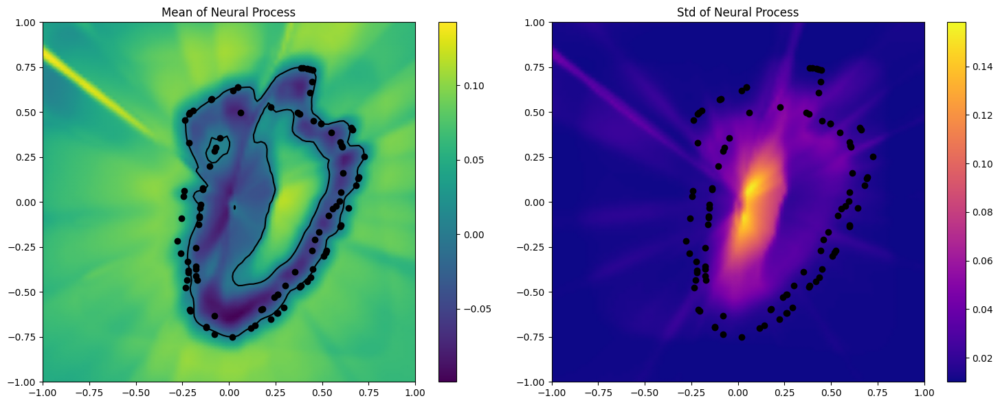

torch.Size([1, 100, 2])


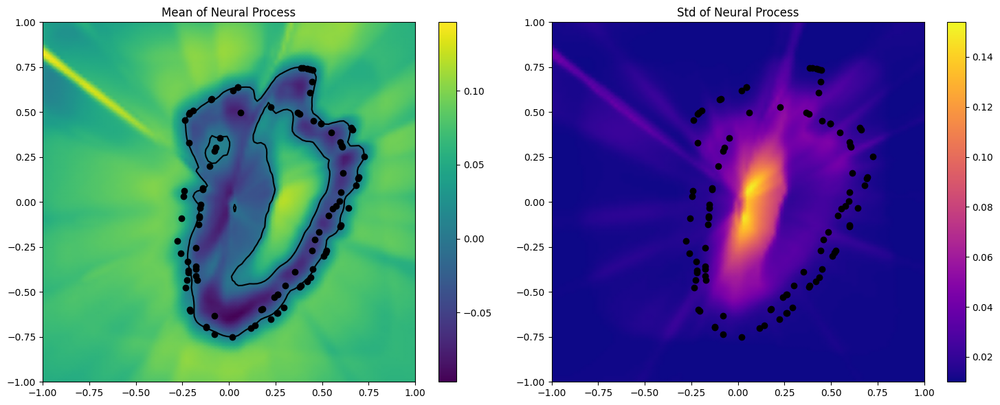

Epoch 21:  46%|███████▎        | 215/469 [02:33<02:57,  1.43batch/s, loss=-2.33]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 21: 100%|████████████████| 469/469 [05:34<00:00,  1.40batch/s, loss=-2.37]


Epoch: 21, Avg_loss: -2.3786265158704096


Epoch 22:   0%|                  | 1/469 [00:01<06:04,  1.28batch/s, loss=-2.35]

Original Label:  tensor(6)
torch.Size([1, 100, 2])


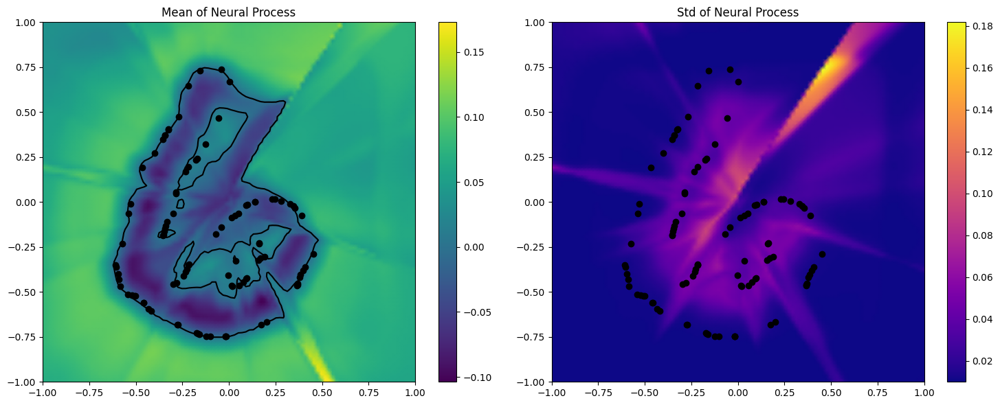

torch.Size([1, 100, 2])


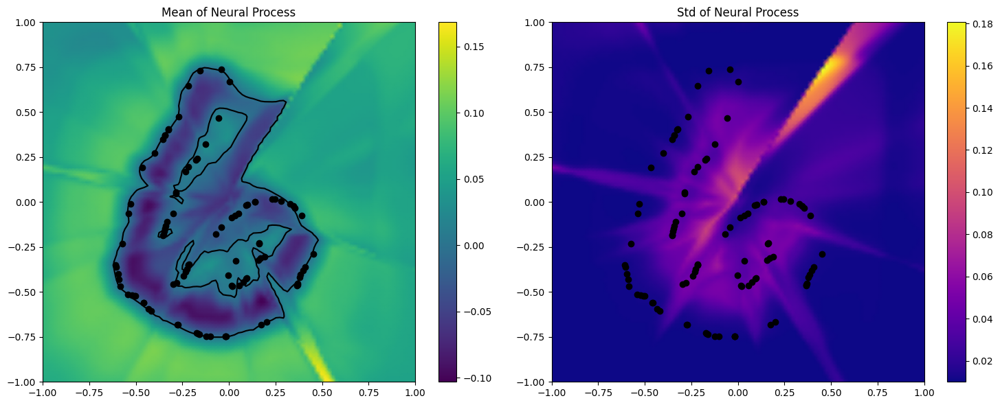

Epoch 22:  76%|████████████▏   | 358/469 [04:15<01:20,  1.38batch/s, loss=-2.37]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 22: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.38]


Epoch: 22, Avg_loss: -2.38033704717022


Epoch 23:   0%|                  | 1/469 [00:01<06:02,  1.29batch/s, loss=-2.37]

Original Label:  tensor(9)
torch.Size([1, 100, 2])


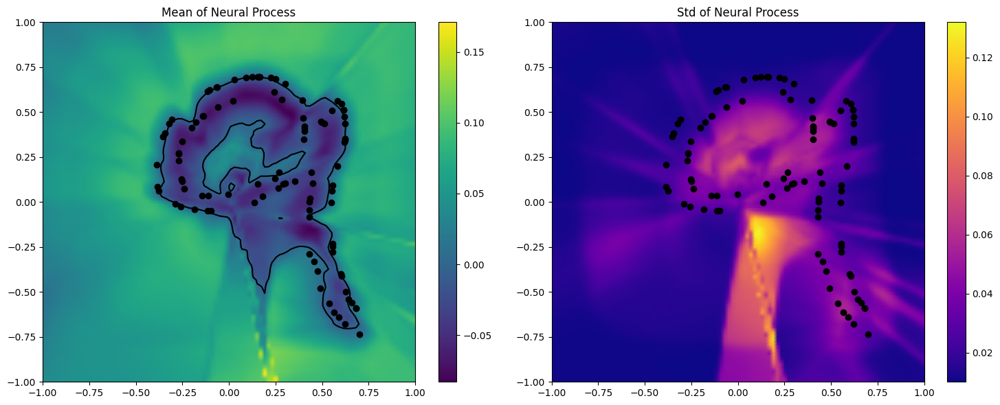

torch.Size([1, 100, 2])


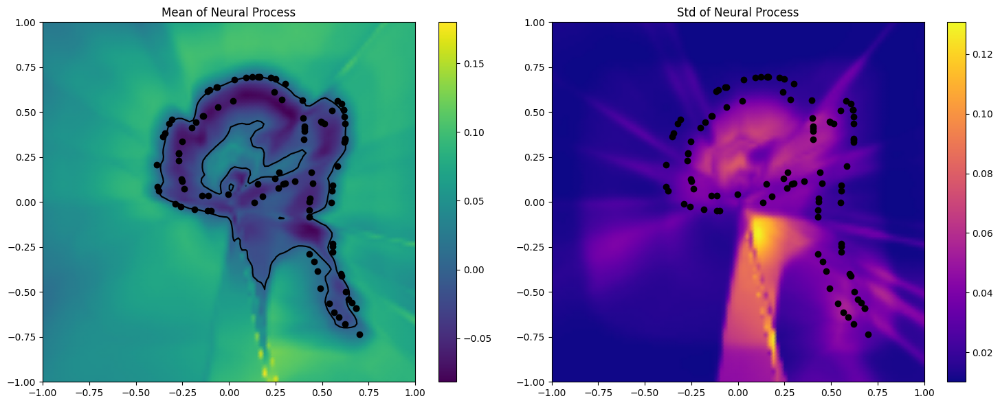

Epoch 23:  91%|███████████████▍ | 425/469 [05:02<00:31,  1.41batch/s, loss=-2.3]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 23: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.37]


Epoch: 23, Avg_loss: -2.389171827576562


Epoch 24:   0%|                  | 1/469 [00:00<05:54,  1.32batch/s, loss=-2.41]

Original Label:  tensor(7)
torch.Size([1, 100, 2])


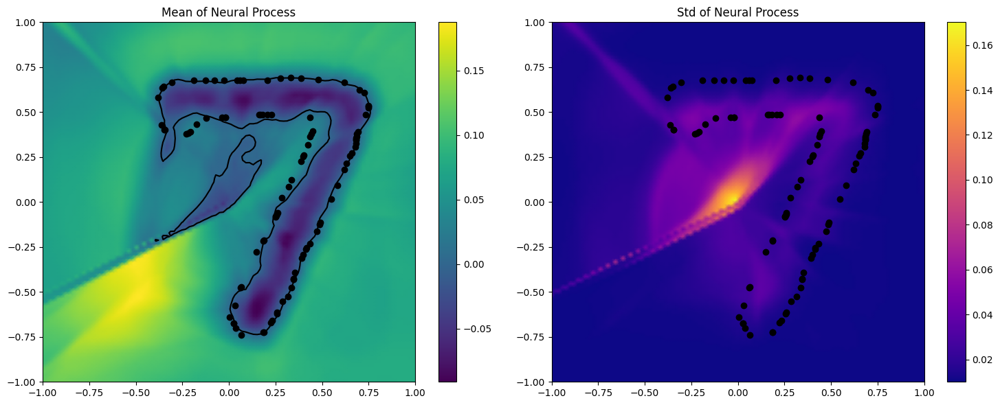

torch.Size([1, 100, 2])


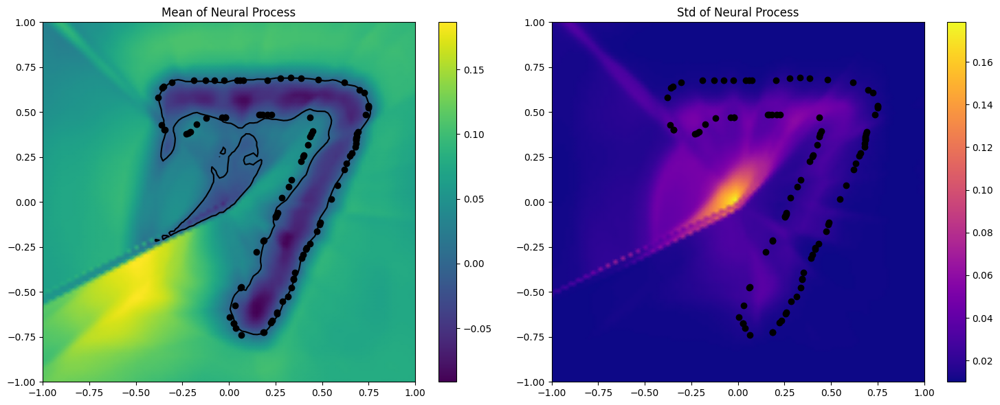

Epoch 24:  63%|██████████▋      | 296/469 [03:31<02:04,  1.39batch/s, loss=-2.4]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 24: 100%|████████████████| 469/469 [05:34<00:00,  1.40batch/s, loss=-2.36]


Epoch: 24, Avg_loss: -2.390530957341957


Epoch 25:   0%|                  | 1/469 [00:01<05:53,  1.33batch/s, loss=-2.33]

Original Label:  tensor(9)
torch.Size([1, 100, 2])


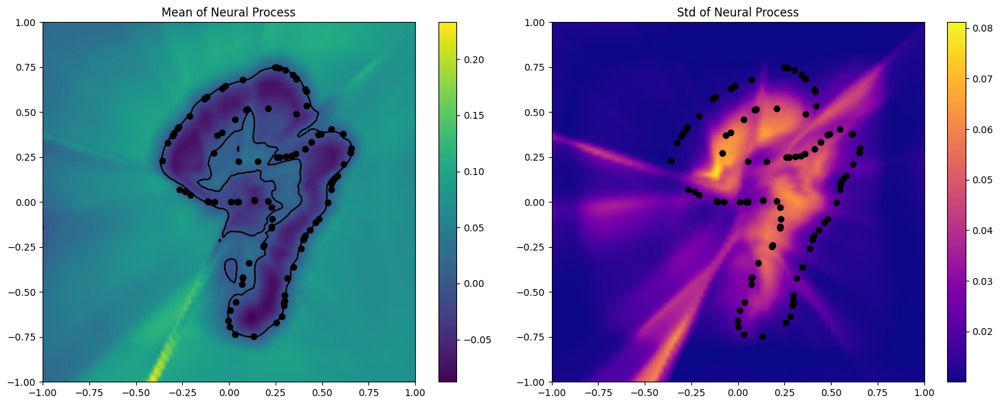

torch.Size([1, 100, 2])


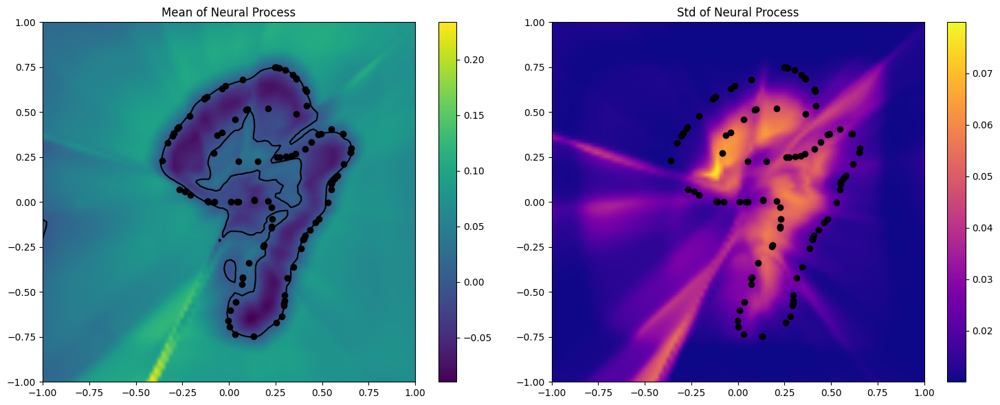

Epoch 25:  24%|████▏            | 114/469 [01:22<04:09,  1.42batch/s, loss=-2.4]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 25: 100%|████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.46]


Epoch: 25, Avg_loss: -2.3955407615409476


Epoch 26:   0%|                  | 1/469 [00:00<05:47,  1.35batch/s, loss=-2.36]

Original Label:  tensor(5)
torch.Size([1, 100, 2])


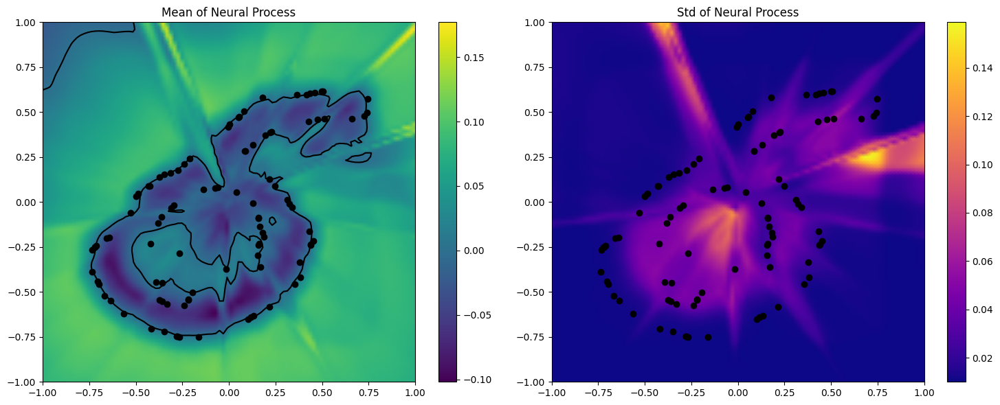

torch.Size([1, 100, 2])


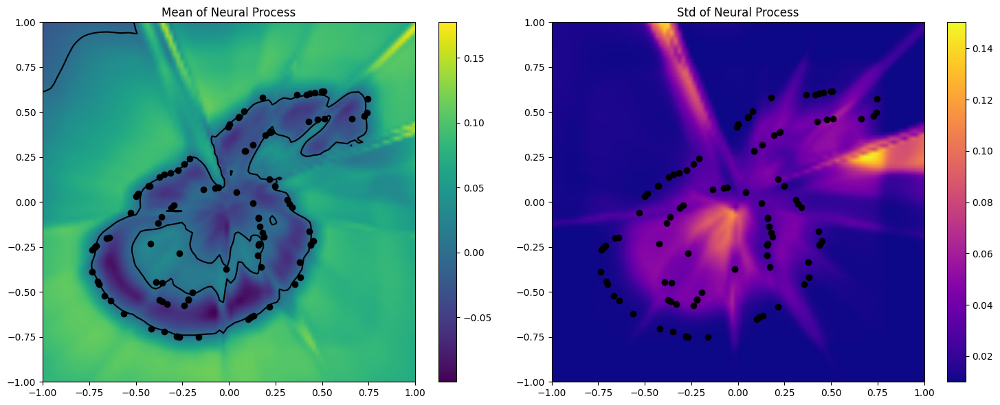

Epoch 26:  78%|████████████▌   | 368/469 [04:21<01:12,  1.40batch/s, loss=-2.41]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 26: 100%|████████████████| 469/469 [05:32<00:00,  1.41batch/s, loss=-2.43]


Epoch: 26, Avg_loss: -2.4001668460333527


Epoch 27:   0%|                  | 1/469 [00:01<05:59,  1.30batch/s, loss=-2.38]

Original Label:  tensor(5)
torch.Size([1, 100, 2])


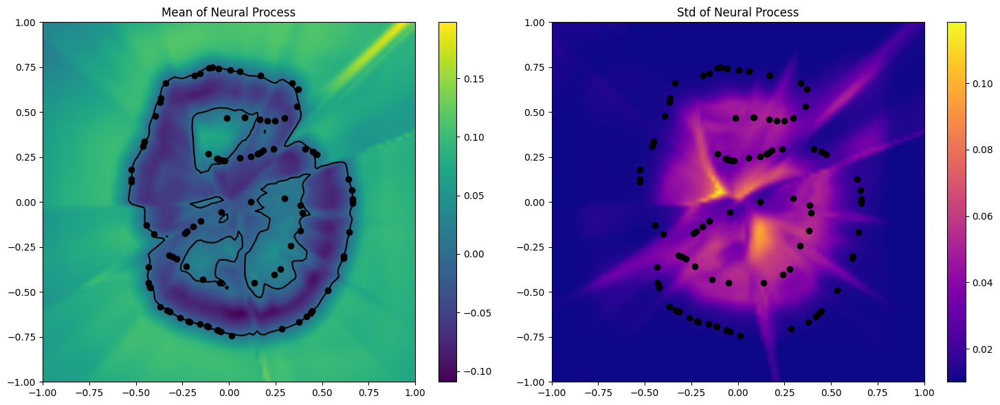

torch.Size([1, 100, 2])


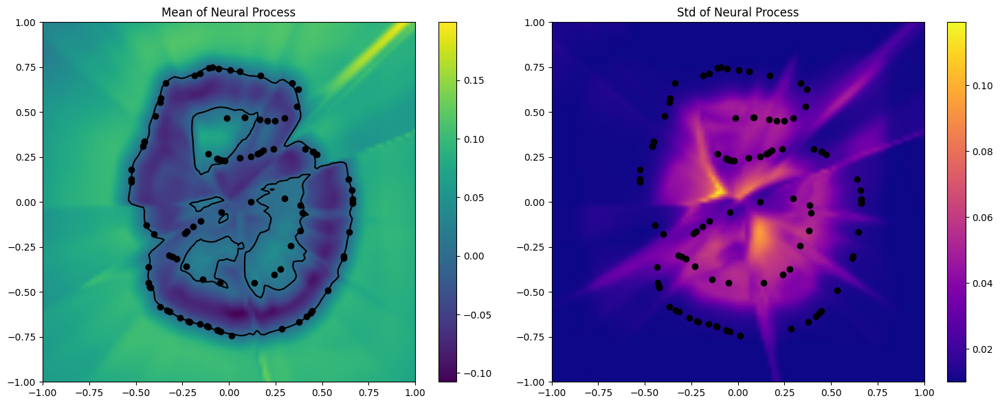

Epoch 27:  99%|███████████████▊| 465/469 [05:31<00:02,  1.42batch/s, loss=-2.39]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 27: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.44]


Epoch: 27, Avg_loss: -2.403518635581043


Epoch 28:   0%|                  | 1/469 [00:01<06:06,  1.28batch/s, loss=-2.42]

Original Label:  tensor(8)
torch.Size([1, 100, 2])


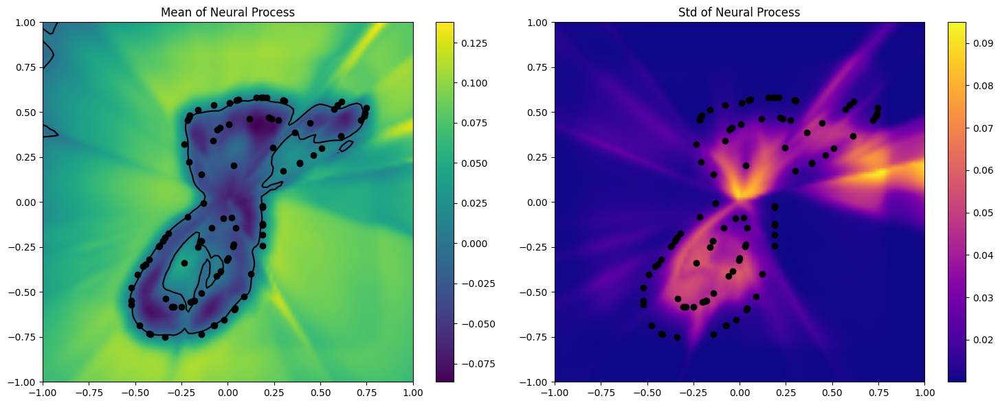

torch.Size([1, 100, 2])


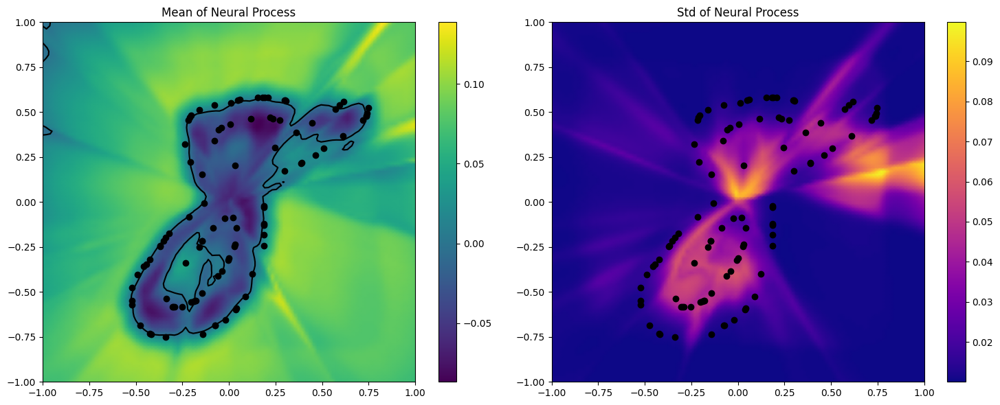

Epoch 28:  23%|███▋            | 107/469 [01:17<04:16,  1.41batch/s, loss=-2.35]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 28: 100%|████████████████| 469/469 [05:34<00:00,  1.40batch/s, loss=-2.44]


Epoch: 28, Avg_loss: -2.4104235456950627


Epoch 29:   0%|                  | 1/469 [00:01<06:03,  1.29batch/s, loss=-2.44]

Original Label:  tensor(3)
torch.Size([1, 100, 2])


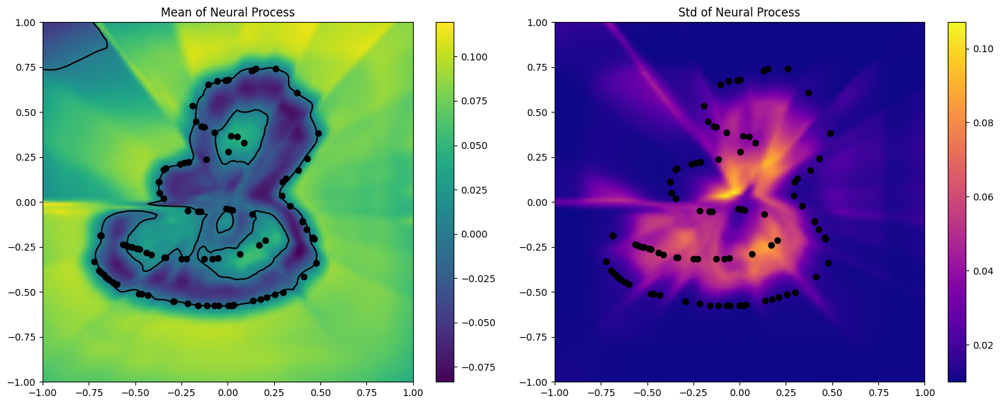

torch.Size([1, 100, 2])


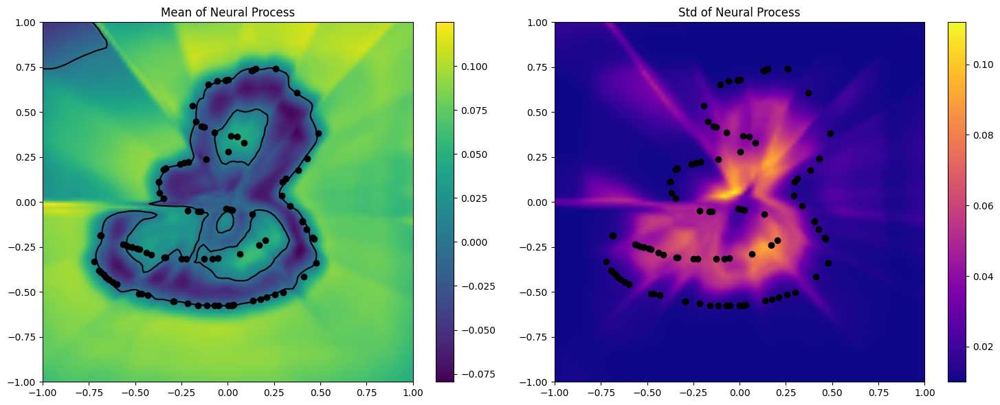

Epoch 29:  14%|██▎              | 65/469 [00:47<04:52,  1.38batch/s, loss=-2.42]

probabilities contain NaN
6
(3, 2)
[[0.75       0.39366516]
 [0.75       0.39366516]
 [0.75       0.39366516]]
(2, 2)
Skipping invalid item due to: probabilities contain NaN


Epoch 29: 100%|████████████████| 469/469 [05:33<00:00,  1.41batch/s, loss=-2.45]

Epoch: 29, Avg_loss: -2.4127433030590066


In [22]:
train(model, optim, train_dataloader,test_dataloader, epochs, n_context, n_target)

Original Label:  tensor(6)
torch.Size([1, 100, 2])


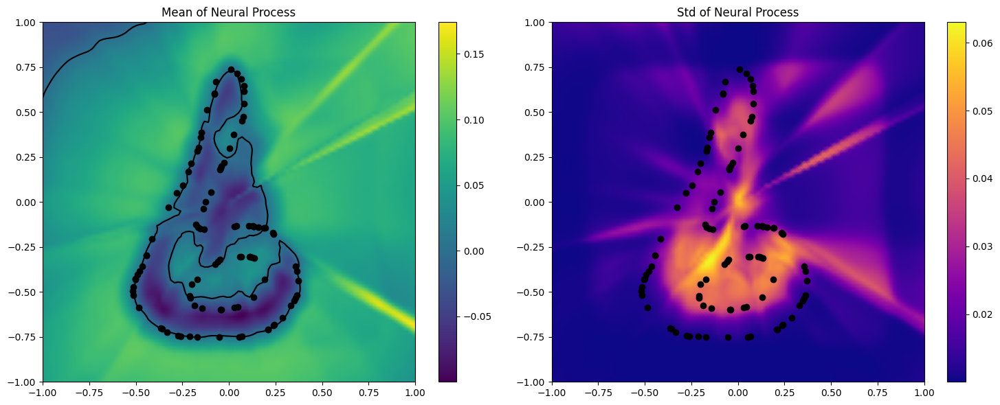

torch.Size([1, 100, 2])


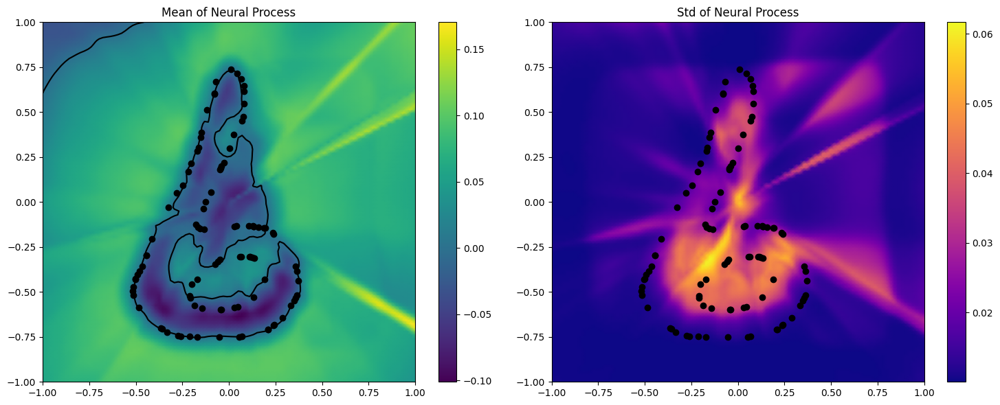

In [23]:
for _ in range(1):
    y_pred, kl, loss, y_std = test(model,test_dataloader, plot=True, size=100)

/tmp/ipykernel_503/2627860310.py:15: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  context_x, context_y = torch.tensor(context_x, dtype=torch.float32), torch.tensor(context_y,dtype=torch.float32)


Original Label:  tensor(6)
N context points:  25
torch.Size([1, 25, 2])


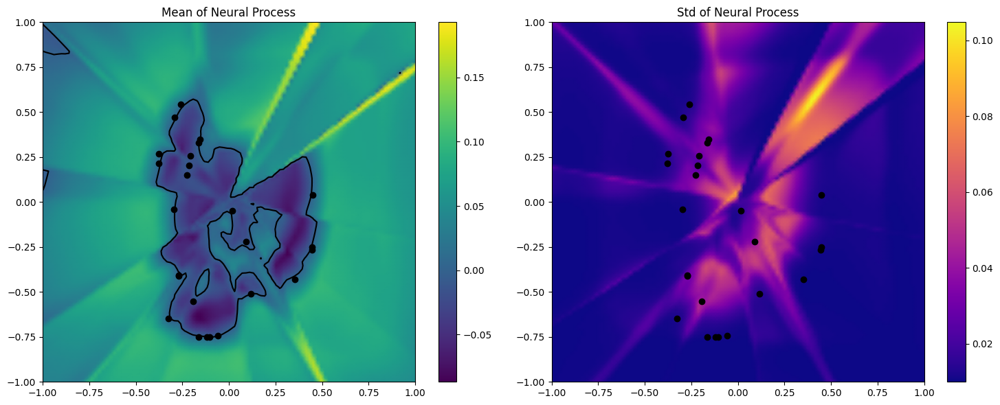

Sample:  0
torch.Size([1, 25, 2])


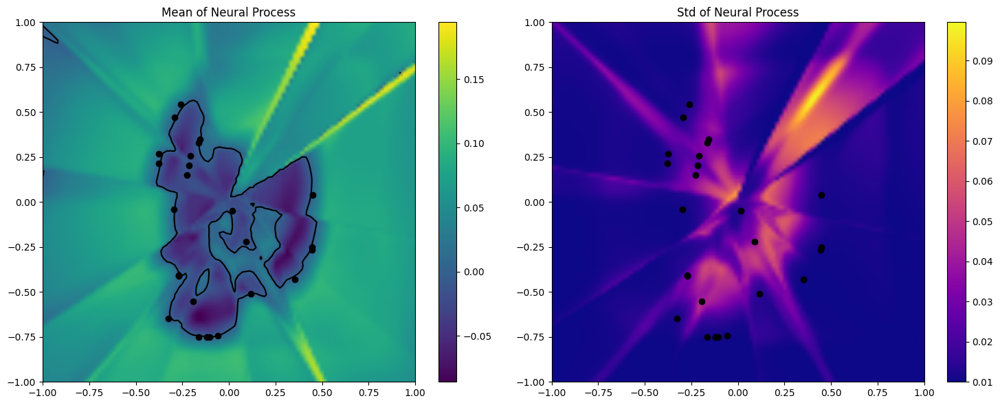

Sample:  1
torch.Size([1, 25, 2])


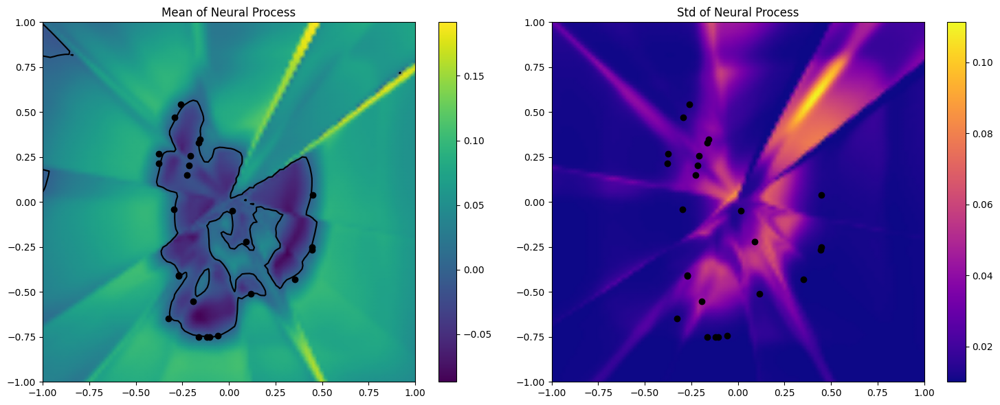

Sample:  2
torch.Size([1, 25, 2])


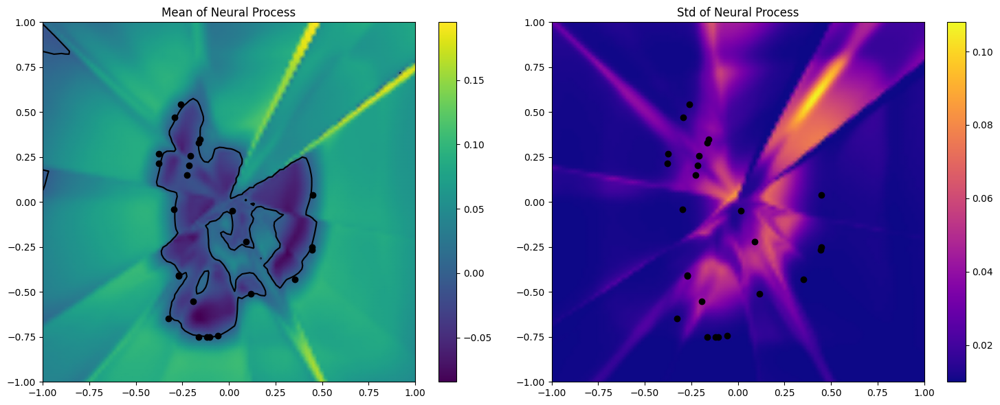

Sample:  3
torch.Size([1, 25, 2])


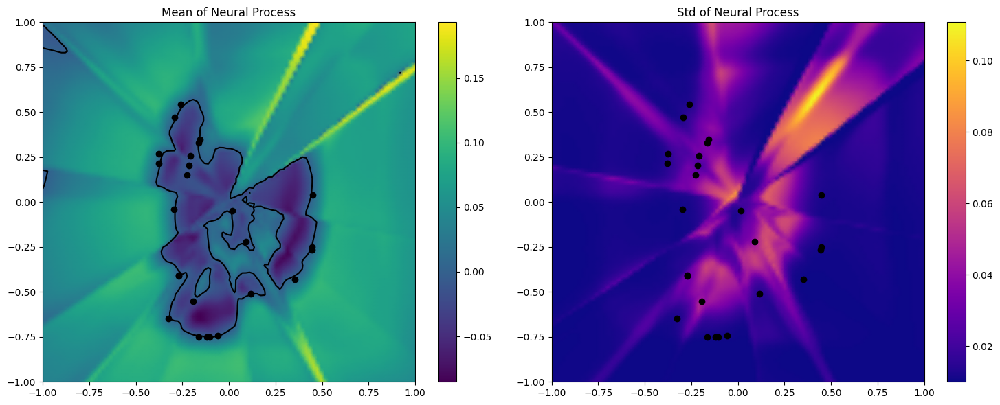

Sample:  4
torch.Size([1, 25, 2])


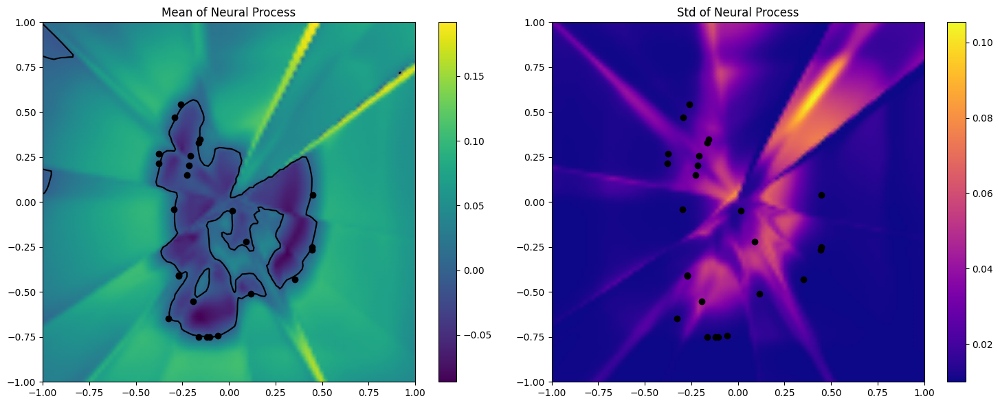

Sample:  5
torch.Size([1, 25, 2])


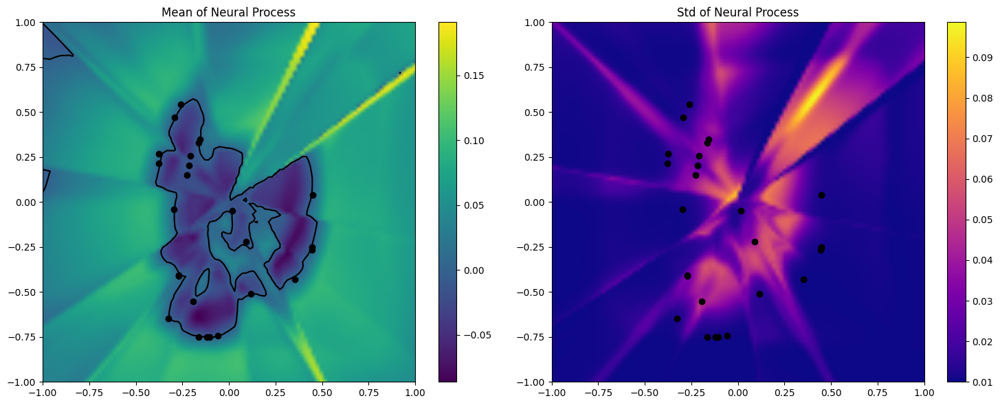

Sample:  6
torch.Size([1, 25, 2])


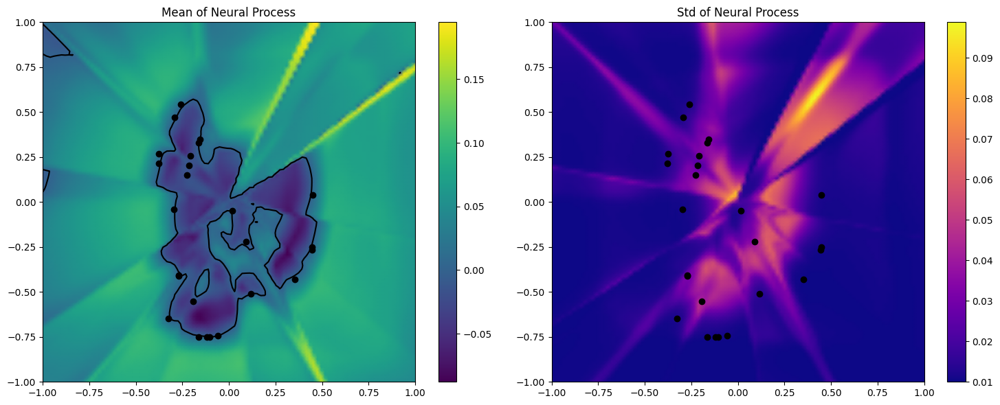

Sample:  7
torch.Size([1, 25, 2])


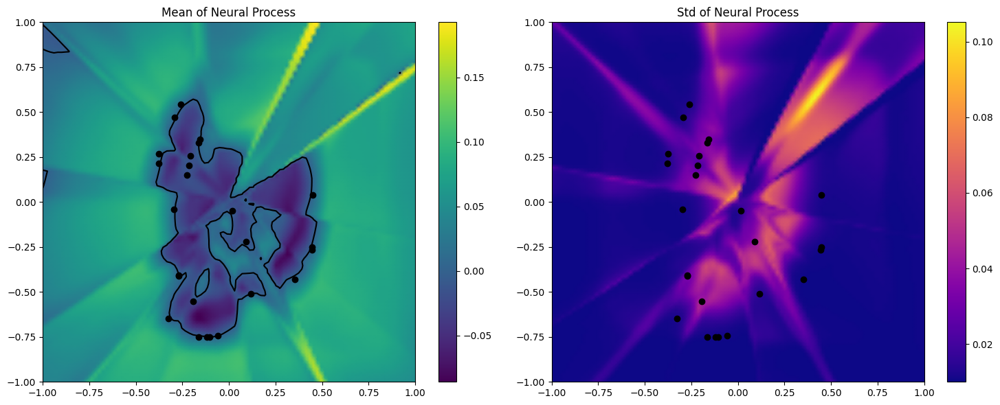

Sample:  8
torch.Size([1, 25, 2])


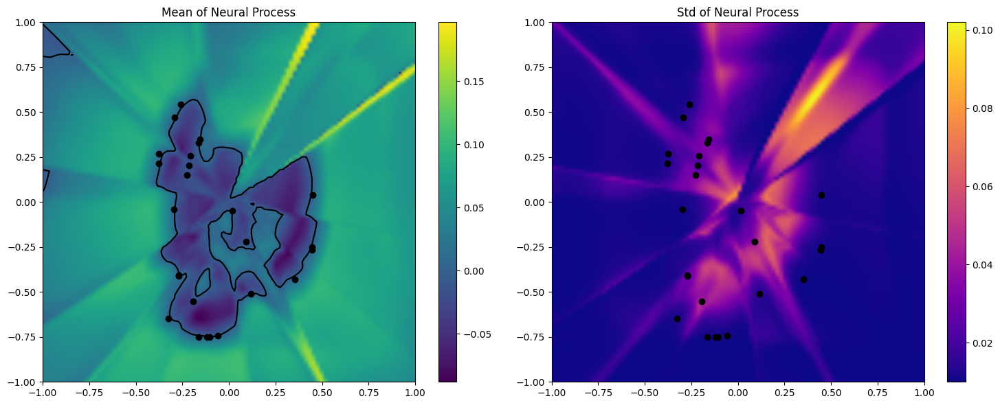

Sample:  9
torch.Size([1, 25, 2])


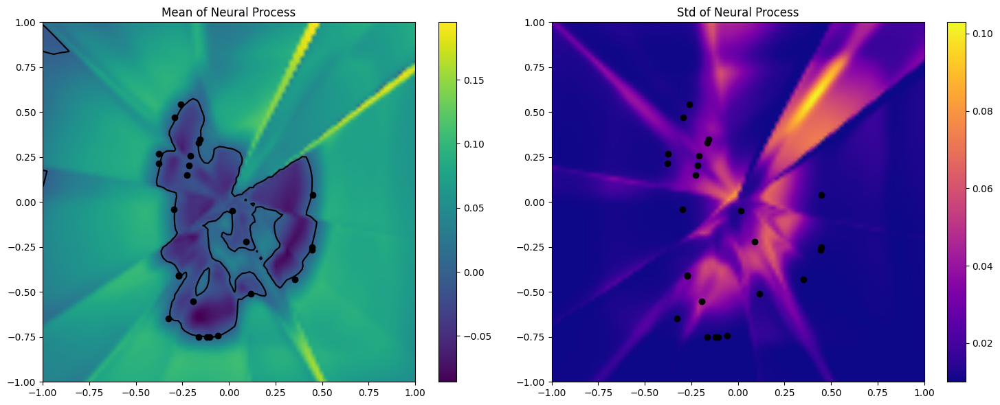

In [24]:
test_progress(model,test_dataloader, plot=True, sizes=[25])